Contact: pedro.romero@meetiqm.com & manish.thapa@meetiqm.com

# Import required packages

In [1]:
from itertools import chain
import math

from IPython.core.display import HTML
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
from qiskit import QuantumCircuit, transpile
from qiskit.quantum_info import Clifford, random_clifford
import qiskit.quantum_info as qi
from qiskit.visualization import plot_histogram

from iqm.pulla.pulla import Pulla
from iqm.pulla.utils_qiskit import qiskit_to_pulla, station_control_result_to_qiskit
from iqm.pulse.playlist.visualisation.base import inspect_playlist
from iqm.qiskit_iqm import IQMProvider


# Matplotlib settings
mpl.rcParams['figure.dpi'] = 500

# Backend set up

In [ ]:
%env IQM_AUTH_SERVER=https://charon.mx03.iqm.fi/auth
%env IQM_AUTH_USERNAME=username
%env IQM_AUTH_PASSWORD=password

In [ ]:
cocos_url = "https://charon.mx03.iqm.fi/cocos"
station_control_url = "https://charon.mx03.iqm.fi/station"

p = Pulla(station_control_url=station_control_url)
compiler = p.get_standard_compiler()

provider = IQMProvider(cocos_url)
backend = provider.get_backend()


def qubit_names_to_index(name_list, backend):
    return [backend.qubit_name_to_index(name) for name in name_list]


def index_to_qubit_names(index_list, backend):
    return [backend.index_to_qubit_name(index) for index in index_list]

# Clifford Randomized Benchmarking

NB: Familiarity with quantum channels, gates and Clifford gates is assumed.

#### Function to generate Clifford RB circuits

The idea behind Clifford Randomized Benchmarking (CRB) is that under certain (simplified) types of noise, the average survival probability of the initial state of a quantum system under uniformly random sequences of multi-qubit Clifford gates with sequence inversion will decay exponentially in the length of the sequences. From such decay, one can in turn infer the average fidelity of the corresponding Clifford group.

CRB sequences are of the form $$\mathcal{S}_m:=\mathcal{C}_{m+1}\circ\mathcal{C}_m\circ\cdots\circ\mathcal{C}_1,$$ for any $m\geq1$, where $\mathcal{C}_i(\cdot):=C_i(\cdot)C_i^\dagger$ is a unitary channel with $C_i$ being a Clifford gate, and where by definition $$\mathcal{C}_{m+1}=(\mathcal{C}_m\circ\cdots\circ\mathcal{C}_1)^{-1}.$$ It is important to notice that $C_{m+1}$ is itself a Clifford gate, i.e., one would not implement the sequence $\mathcal{C}_m\circ\cdots\circ\mathcal{C}_1$ in practice, but rather compile the corresponding unitary operator $C_mC_{m-1}\cdots{C}_1$ into a single Clifford gate.

The main assumption is that the real noisy gates can be approximately modeled independently by a quantum channel $\mathcal{E}$ (completely positive, trace non-increasing map) as $\tilde{\mathcal{C}}_i\approx\mathcal{E}\circ\mathcal{C}_i$, or (ultimately equivalently) as $\tilde{\mathcal{C}}_i\approx\mathcal{C}_i\circ\mathcal{E}$. This implies that the noise is modeled as **Markovian**, **time-stationary** and **gate-independent** --- while here we will take these for granted, a lot about RB in more general regimes is known, but it is in general more complicated, and often this simplistic scenario goes a long way as a useful first approximation.

In [11]:
from qiskit.circuit.library import HGate, SGate


def circuit_crb_dd(n_qubits, seq_length):
    """Generates a random circuit with gates uniformly sampled at random from multi-qubit Clifford group, with final measurement.

    Arguments:
        n_qubits: Number of qubits where RB will be done
        seq_length: The RB sequence length
    Returns:
        QuantumCircuit: A circuit with Clifford RB on n_qubits and idling on an ancilla qubit
    """
    # Initialize the full RB + dd_qubit quantum circuit
    qc = QuantumCircuit(n_qubits + 1)

    # Initialize a circuit to compile the inverse of the RB sequence
    qc_inv = QuantumCircuit(n_qubits)

    # Fix the gate
    h_gate = HGate()
    s_gate = SGate()
    circuit = QuantumCircuit(1)
    circuit.append(h_gate, [0])
    circuit.barrier([0])
    circuit.append(s_gate, [0])
    clifford_dd_qubit = circuit.to_instruction()

    for m in range(seq_length):
        # Sample a random Clifford
        clifford = random_clifford(n_qubits).to_instruction()

        # Compose the sampled Clifford in the circuit and add a barrier
        qc.compose(clifford, qubits=list(range(n_qubits)), inplace=True)
        qc_inv.compose(clifford, qubits=list(range(n_qubits)), inplace=True)

        # The base case will be for seq_length=1 !
        if m == 0:
            qc.compose(clifford_dd_qubit, qubits=[n_qubits], inplace=True)
            qc.barrier()  # NB: mind the barriers!
        elif m == seq_length - 1:
            continue
        else:
            qc.barrier(list(range(n_qubits)))

    # Compile and compose the inverse
    qc.barrier()
    compiled_inverse_clifford = Clifford(qc_inv).to_instruction().inverse()
    qc.compose(compiled_inverse_clifford, qubits=list(range(n_qubits)), inplace=True)

    qc.compose(clifford_dd_qubit.inverse(), qubits=[n_qubits], inplace=True)

    # Add measurement
    qc.measure_all()

    return qc

#### Fix the number of qubits

NB: CRB is not generally intended to work for $n>2$, both because of the scaling of the size of the $n$-qubit Clifford group in $n$, and because such gates have to eventually be transpiled to a native basis of 1Q and 2Q gates!

In [12]:
qubit_indices = [4]
num_qubits = len(qubit_indices)
dd_qubit = [2]

#### Inspect a circuit sample - pick an arbitrary sequence length

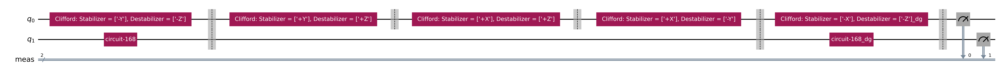

In [13]:
sample_length = 4
crb_circuit_sample = circuit_crb_dd(num_qubits, sample_length)
crb_circuit_sample.draw(output='mpl', fold=-1, style='iqp')

#### Check that the circuit implements an identity modulo a phase

In [14]:
sample_operator = crb_circuit_sample.copy()
sample_operator.remove_final_measurements()
op = qi.Operator(sample_operator)
is_id = op.equiv(qi.Pauli('I' * num_qubits))
print(f"The unitary of the circuit implements identity: {is_id}")
display(op.draw(output="latex"))

The unitary of the circuit implements identity: False


<IPython.core.display.Latex object>

#### Transpiling the circuit to IQM's backend

In [15]:
# Set an optimization level for Qiskit's optimizer
qiskit_optim_level = 1

While a high level of optimization in transpile is usually desirable, one must be careful for the optimization not to mess with the Clifford gates, i.e., we want the transformations between barriers in the circuit to implement a Clifford regardless of how it is decomposed. The specific decomposition still matters, however, because the (average) number of 2Q and 1Q gates (i.e., `cz` and `r`, respectively) will dictate how noisily we can implement the Cliffords on average, i.e., the average gate fidelity we will ultimately obtain.

We will not do this check here, but it is now known that a *good* decomposition of Clifford gates in our basis will have on average 8.25 `cz` gates and 1.5 `r` gates (e.g., see [arXiv:1402.4848](https://arxiv.org/abs/1402.4848)).

In [16]:
crb_circuit_sample_transp = transpile(
    crb_circuit_sample,  # The circuit to be transpiled
    backend=backend,  # The backend to transpile to
    optimization_level=qiskit_optim_level,
    initial_layout=qubit_indices + dd_qubit,  # The initial mapping of virtual to physical qubits
)

We can count the number of native 1Q and 2Q gates by using the circuit attribute `count_ops()`

#### Averaging RB sequences over Clifford gates

One important reason why CRB works --and why specifically it uses Clifford gates--, is that the uniformly distributed multi-qubit Clifford group forms a unitary 2-design. This essentially means that any quantity that takes two copies of the pair $C, C^\dagger$ and then averaged over all possible $C$s, will be exactly the same as if $C$ had been *any* uniformly distributed (so-called Haar) random unitary. This matters because there are plenty of results allowing to easily compute such quantities (i.e., second moments) over the whole uniformly distributed unitary group --- in fact, such second moment simply takes the form of a depolarizing channel (RB precisely extracts the average gate fidelity through the corresponding polarization parameter).

The CRB sequences are quantities of this type because of the final inverse at the end (i.e. all sequences will have 2 copies of pairs $C_i,C_i^\dagger$ for all $i=1,2,\ldots,m$). This is the reason why the theory behind RB, under the noise assumptions above, can ensure that the decay in average fidelity, i.e., quantities like $$f_0=\langle0|\mathcal{S}_m(|0\rangle\!\langle0|)|0\rangle$$ take the form of a function $$f_0=Ap^m+B$$ for $0\leq{A,B,p}\leq1$.

Furthermore, it ensures that $p$ will encode the average gate fidelity of the noisy Clifford gates, whilst $A,B$ will encode (and isolate) errors due to state preparation and measurement. This is what is meant by RB being SPAM-robust. In the modeling with assummptions of noisy gates above, this means $p\sim\int{d}\psi\langle\psi|\mathcal{E}(|\psi\rangle\!\langle\psi|)|\psi\rangle$ for all possible uniformly distributed pure states $|\psi\rangle$, and $A\sim\langle0|\mathcal{E}_\text{spam}(|0\rangle\!\langle0|)|0\rangle$, $B\sim\langle0|\mathcal{E}_\text{spam}(\mathbb{I}/2^n)|0\rangle$ for a composition of the state preparation and measurement noise.

### Execute on IQM's backend

We may now fix a number of circuit samples and sequence lengths.

Despite the Clifford group having a (super) exponential amount of terms (e.g., 24 for 1Q, then 11,520 for 2Q), approximating the average over the whole group with finite samples quickly converges to the Haar average.

On the other hand, the sequence lengths can be chosen as exponentially spaced and aiming at long sequences, if possible, serves to better determine the offset constant (often named the *nuisance* parameter, for obvious reasons) in the decay.

In [17]:
num_circuit_samples = 25
sequence_lengths = np.geomspace(1, 150, num=8, endpoint=True, dtype=int).tolist()

Depending on how many circuits we want to execute, we could either generate all circuit samples for all circuit lengths and send all for execution once, or we may, for example, generate a given amount of circuits, send them to execution while meanwhile continuing to generate circuits and sending them. In either case, one may retrieve the results later.

Here we will generate all circuits for all sequence lengths, and send them to execute as a single batch on the backend.

#### Function to generate a number of Clifford RB circuit samples for given sequence lengths

It is generally a good idea to store (at least at this stage) both the abstract and the transpiled circuits, so that we can inspect them later on.

In [18]:
def generate_crb_samples(num_samples, seq_lengths, qiskit_optim_level=1, ini_layout=qubit_indices + dd_qubit):
    """Generates a number of crb circuit samples at given sequence lengths.

    Arguments:
        num_samples (int): the number of crb circuit samples
        seq_lengths (list[int]): the sequence lengths of the samples
    Returns:
        dict[int, list[QuantumCircuit]]: A dictionary of CRB circuits at given sequence lengths
    """
    # We will use a dictionary to store all circuits, with keys being sequence lenghts
    all_samples = {}
    all_samples_transpiled = {}

    for m in seq_lengths:
        samples_at_length_m = []
        samples_at_length_m_transpiled = []
        for _ in range(num_samples):
            circuit_samples = circuit_crb_dd(num_qubits, m)
            transpiled_circuit_samples = transpile(
                circuit_samples, backend=backend, optimization_level=qiskit_optim_level, initial_layout=ini_layout
            )
            samples_at_length_m.append(circuit_samples)
            samples_at_length_m_transpiled.append(transpiled_circuit_samples)

        all_samples[m] = samples_at_length_m
        all_samples_transpiled[m] = samples_at_length_m_transpiled

    return all_samples, all_samples_transpiled

In [19]:
all_samples, all_samples_transpiled = generate_crb_samples(num_circuit_samples, sequence_lengths)

We can inspect the circuits just as a sanity check

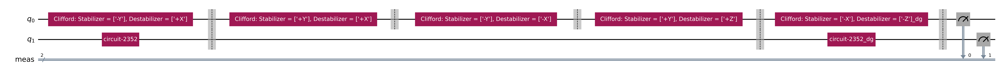

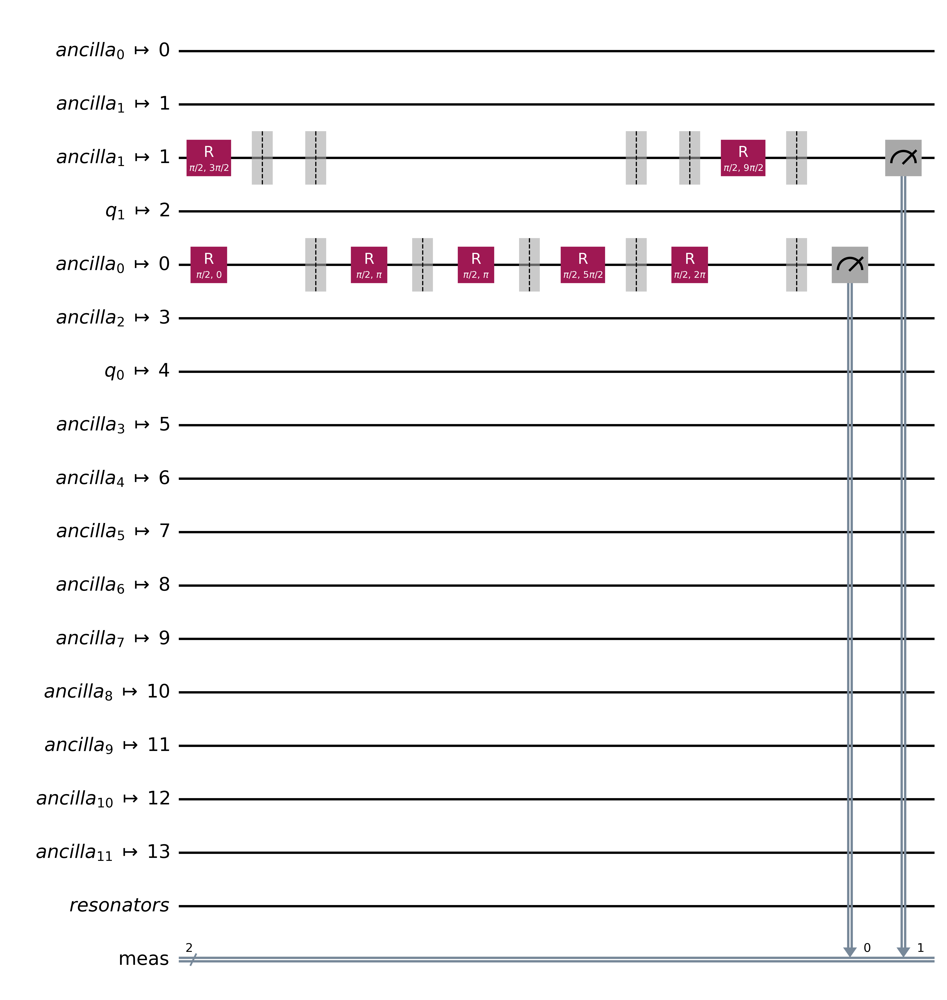

In [20]:
# Pick one of the sequence lengths
m_ex = sequence_lengths[2]

# Pick one of the samples
sample_ex = 5

# Display circuits
display(all_samples[m_ex][sample_ex].draw(output='mpl', style='iqp', fold=0))
display(all_samples_transpiled[m_ex][sample_ex].draw(output='mpl', style='iqp', fold=0))

**Task**: Count the average number of 1Q and 2Q gates in the circuits for each sequence length.

**Task**: Since the Clifford group is a 2-design, its so-called *frame potential* (see e.g., [arXiv:1610.04903](https://arxiv.org/abs/1610.04903)) has to satisfy $\displaystyle{\sum_{k,\,k^\prime=1}^K}\left|\mathrm{tr}\left(C_{k^\prime}^{\dagger}C_k\right)\right|^4/K^2 = 2$. Verify this condition for the 1Q Clifford group. **warning** for the 2Q Clifford group: there are in total $n=11,520^2 = 132,710,400$ values in the sum! It suffices to compute the values in a triangular part of the matrix $U_{k^\prime}^{\dagger}U_k$  --- so you can definitely verify this property, however there will still be $n(n-1)/2$ such terms for your computer to sum up! 

#### Submit circuits to execute

We can now send the transpiled circuits to be run on the hardware.

NB: It is generally preferable to use `backend.run` instead of `execute` command, since the latter performs a transpilation pass "under the hood".

In [29]:
from iqm.cpc.compiler.dd import DDStrategy
from iqm.cpc.interface.compiler import (
    CircuitBoundaryMode,
    CircuitExecutionOptions,
    DDMode,
    HeraldingMode,
    MeasurementMode,
    MoveGateFrameTrackingMode,
    MoveGateValidationMode,
)
from iqm.pulla.utils_dd import generate_phases_of_urn_sequence


alignment = "alap"
shots = 10000


def submit_all(transp_circuits):
    """Submit all jobs."""

    all_jobs = {}
    print("Submitting all circuits for execution")
    for m in transp_circuits.keys():
        all_jobs_m = []
        for circuit_sample in transp_circuits[m]:
            c, compiler = qiskit_to_pulla(p, backend, circuit_sample)

            context = compiler.compiler_context()
            data = c
            phases = generate_phases_of_urn_sequence(8)

            gate_sequences_with_generic_gates = [
                (
                    2,
                    [
                        (math.pi, 0),
                        (math.pi, 0),
                    ],
                    alignment,
                ),
                (
                    5,
                    [
                        (math.pi, math.pi / 2),
                        (math.pi, 0),
                        (math.pi, math.pi / 2),
                        (math.pi, 0),
                    ],
                    "center",
                ),
                (
                    9,
                    [(math.pi, phase) for phase in phases],
                    alignment,
                ),
            ]

            dd_strategy = DDStrategy()
            dd_strategy.gate_sequences = [gate_sequences_with_generic_gates[2]]
            dd_strategy.target_qubits = frozenset(["QB3"])

            compiler.options = CircuitExecutionOptions(
                measurement_mode=MeasurementMode.CIRCUIT,
                heralding_mode=HeraldingMode.NONE,
                dd_mode=DDMode.ENABLED,
                dd_strategy=dd_strategy,
                circuit_boundary_mode=CircuitBoundaryMode.ALL,
                move_gate_frame_tracking=MoveGateFrameTrackingMode.FULL,
                move_gate_validation=MoveGateValidationMode.STRICT,
                active_reset_cycles=None,
            )

            playlist, context = compiler.compile(data)

            settings, context = compiler.build_settings(context, shots=shots)
            settings.options.averaging_bins = shots
            settings.options

            response_with_dd = p.execute(playlist, context, settings)
            all_jobs_m.append(response_with_dd)

        all_jobs[m] = all_jobs_m

    print("All jobs submitted OK")
    return all_jobs, compiler.options, playlist


def retrieve_all(all_jobs, compiler_options):
    """Retrieve all jobs."""

    retrieved_counts = {}

    for index, m in enumerate(all_jobs.keys()):
        all_counts_m = []
        total_jobs = len(list(all_jobs.keys()))
        print(f"Retrieving results for sequence length {m} ({(index+1)}/{total_jobs})")
        for job in all_jobs[m]:
            qiskit_result = station_control_result_to_qiskit(
                station_control_result=job, shots=shots, execution_options=compiler_options
            )
            counts_dd = qiskit_result.get_counts()
            all_counts_m.append(counts_dd)
        retrieved_counts[m] = all_counts_m

    print("All results retrieved OK")
    return retrieved_counts

In [30]:
submitted_jobs, compiler_options, playlist = submit_all(all_samples_transpiled)
HTML(inspect_playlist(playlist, range(1)))

Submitting all circuits for execution
[04-17 15:18:14;I] Submitted sweep with ID: 287f73a9-1b8f-4a99-9a4a-f0337bc76a38
[04-17 15:18:14;I] Created task in queue with ID: 0b832916-6747-4f85-9fa5-aa78ecf85bd1
[04-17 15:18:14;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/287f73a9-1b8f-4a99-9a4a-f0337bc76a38
[04-17 15:18:14;I] Task link: http://charon.mx03.iqm.fi/station/tasks/0b832916-6747-4f85-9fa5-aa78ecf85bd1
[04-17 15:18:14;I] Waiting for the sweep to finish...
[04-17 15:18:14;I] Celery task ID: 0b832916-6747-4f85-9fa5-aa78ecf85bd1
[04-17 15:18:20;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:18:21;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0],

[04-17 15:18:21;I] Submitted sweep with ID: 2afc7664-ca90-4e0f-ae69-a8c4debd5ebd
[04-17 15:18:21;I] Created task in queue with ID: f26bc2b2-f97a-47a7-93e6-6c37ff3d76b2
[04-17 15:18:21;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/2afc7664-ca90-4e0f-ae69-a8c4debd5ebd
[04-17 15:18:21;I] Task link: http://charon.mx03.iqm.fi/station/tasks/f26bc2b2-f97a-47a7-93e6-6c37ff3d76b2
[04-17 15:18:21;I] Waiting for the sweep to finish...
[04-17 15:18:22;I] Celery task ID: f26bc2b2-f97a-47a7-93e6-6c37ff3d76b2
[04-17 15:18:28;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:18:28;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0

[04-17 15:18:29;I] Submitted sweep with ID: 94e4cf59-e5e2-40bf-ab34-4b940755c7e0
[04-17 15:18:29;I] Created task in queue with ID: 37caae6f-0568-4014-9f74-49e140782313
[04-17 15:18:29;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/94e4cf59-e5e2-40bf-ab34-4b940755c7e0
[04-17 15:18:29;I] Task link: http://charon.mx03.iqm.fi/station/tasks/37caae6f-0568-4014-9f74-49e140782313
[04-17 15:18:29;I] Waiting for the sweep to finish...
[04-17 15:18:29;I] Celery task ID: 37caae6f-0568-4014-9f74-49e140782313
[04-17 15:18:35;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:18:36;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:18:37;I] Submitted sweep with ID: 8b9ddec1-0647-49c2-a30c-75d44cf68a53
[04-17 15:18:37;I] Created task in queue with ID: 47e79eb0-487a-4718-8c9f-0c2c7c8b9241
[04-17 15:18:37;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/8b9ddec1-0647-49c2-a30c-75d44cf68a53
[04-17 15:18:37;I] Task link: http://charon.mx03.iqm.fi/station/tasks/47e79eb0-487a-4718-8c9f-0c2c7c8b9241
[04-17 15:18:37;I] Waiting for the sweep to finish...
[04-17 15:18:37;I] Celery task ID: 47e79eb0-487a-4718-8c9f-0c2c7c8b9241
[04-17 15:18:43;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:18:43;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0

[04-17 15:18:44;I] Submitted sweep with ID: e7c71688-0a54-4663-8513-0847a19ca259
[04-17 15:18:44;I] Created task in queue with ID: b47c1808-50d8-454a-91da-02795bde6196
[04-17 15:18:44;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/e7c71688-0a54-4663-8513-0847a19ca259
[04-17 15:18:44;I] Task link: http://charon.mx03.iqm.fi/station/tasks/b47c1808-50d8-454a-91da-02795bde6196
[04-17 15:18:44;I] Waiting for the sweep to finish...
[04-17 15:18:45;I] Celery task ID: b47c1808-50d8-454a-91da-02795bde6196
[04-17 15:18:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:18:51;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:18:52;I] Submitted sweep with ID: 99be9952-6b58-45c2-99bc-aa24d511283d
[04-17 15:18:52;I] Created task in queue with ID: a606734f-4d0b-4756-b373-712c008c778a
[04-17 15:18:52;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/99be9952-6b58-45c2-99bc-aa24d511283d
[04-17 15:18:52;I] Task link: http://charon.mx03.iqm.fi/station/tasks/a606734f-4d0b-4756-b373-712c008c778a
[04-17 15:18:52;I] Waiting for the sweep to finish...
[04-17 15:18:53;I] Celery task ID: a606734f-4d0b-4756-b373-712c008c778a
[04-17 15:18:59;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:18:59;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:19:00;I] Submitted sweep with ID: 605a5883-f2e9-4f19-8911-6d3246445bc6
[04-17 15:19:00;I] Created task in queue with ID: cbd95f36-6b92-4887-8b64-0b20ac617261
[04-17 15:19:00;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/605a5883-f2e9-4f19-8911-6d3246445bc6
[04-17 15:19:00;I] Task link: http://charon.mx03.iqm.fi/station/tasks/cbd95f36-6b92-4887-8b64-0b20ac617261
[04-17 15:19:00;I] Waiting for the sweep to finish...
[04-17 15:19:00;I] Celery task ID: cbd95f36-6b92-4887-8b64-0b20ac617261
[04-17 15:19:06;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:19:07;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:19:07;I] Submitted sweep with ID: 0f028930-11c7-4889-802b-4cc050b00eb1
[04-17 15:19:07;I] Created task in queue with ID: 0443a1d3-b419-487c-8046-07ffdf7b4138
[04-17 15:19:07;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/0f028930-11c7-4889-802b-4cc050b00eb1
[04-17 15:19:07;I] Task link: http://charon.mx03.iqm.fi/station/tasks/0443a1d3-b419-487c-8046-07ffdf7b4138
[04-17 15:19:07;I] Waiting for the sweep to finish...
[04-17 15:19:08;I] Celery task ID: 0443a1d3-b419-487c-8046-07ffdf7b4138
[04-17 15:19:14;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:19:14;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:19:15;I] Submitted sweep with ID: 4ca342ec-dfdb-4161-a0c3-3763e6467693
[04-17 15:19:15;I] Created task in queue with ID: 15430ddb-58a1-42b0-bbfc-2ce4c9c0ced3
[04-17 15:19:15;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/4ca342ec-dfdb-4161-a0c3-3763e6467693
[04-17 15:19:15;I] Task link: http://charon.mx03.iqm.fi/station/tasks/15430ddb-58a1-42b0-bbfc-2ce4c9c0ced3
[04-17 15:19:15;I] Waiting for the sweep to finish...
[04-17 15:19:15;I] Celery task ID: 15430ddb-58a1-42b0-bbfc-2ce4c9c0ced3
[04-17 15:19:21;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:19:21;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:19:22;I] Submitted sweep with ID: 20052642-856e-4a23-ae1e-9bc3b5ed103d
[04-17 15:19:22;I] Created task in queue with ID: 7575b1f9-293f-4338-a596-a5226068cd8e
[04-17 15:19:22;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/20052642-856e-4a23-ae1e-9bc3b5ed103d
[04-17 15:19:22;I] Task link: http://charon.mx03.iqm.fi/station/tasks/7575b1f9-293f-4338-a596-a5226068cd8e
[04-17 15:19:22;I] Waiting for the sweep to finish...
[04-17 15:19:23;I] Celery task ID: 7575b1f9-293f-4338-a596-a5226068cd8e
[04-17 15:19:28;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:19:29;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:19:30;I] Submitted sweep with ID: f1722938-e0e1-4ef1-b780-25dc8b005366
[04-17 15:19:30;I] Created task in queue with ID: e5dbbc90-369e-4de5-b563-fd623551f678
[04-17 15:19:30;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/f1722938-e0e1-4ef1-b780-25dc8b005366
[04-17 15:19:30;I] Task link: http://charon.mx03.iqm.fi/station/tasks/e5dbbc90-369e-4de5-b563-fd623551f678
[04-17 15:19:30;I] Waiting for the sweep to finish...
[04-17 15:19:30;I] Celery task ID: e5dbbc90-369e-4de5-b563-fd623551f678
[04-17 15:19:36;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:19:36;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:19:37;I] Submitted sweep with ID: a3b7af9c-e25d-48de-a804-f73cbac7d19a
[04-17 15:19:37;I] Created task in queue with ID: 1240bf5d-f287-484d-912e-59244ae9bca6
[04-17 15:19:37;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/a3b7af9c-e25d-48de-a804-f73cbac7d19a
[04-17 15:19:37;I] Task link: http://charon.mx03.iqm.fi/station/tasks/1240bf5d-f287-484d-912e-59244ae9bca6
[04-17 15:19:37;I] Waiting for the sweep to finish...
[04-17 15:19:38;I] Celery task ID: 1240bf5d-f287-484d-912e-59244ae9bca6
[04-17 15:19:43;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:19:44;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:19:45;I] Submitted sweep with ID: f325741e-a27c-469c-9c74-82a08c28b1cd
[04-17 15:19:45;I] Created task in queue with ID: 1110ec2c-a062-4f3f-a9b4-c7ad21adc359
[04-17 15:19:45;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/f325741e-a27c-469c-9c74-82a08c28b1cd
[04-17 15:19:45;I] Task link: http://charon.mx03.iqm.fi/station/tasks/1110ec2c-a062-4f3f-a9b4-c7ad21adc359
[04-17 15:19:45;I] Waiting for the sweep to finish...
[04-17 15:19:45;I] Celery task ID: 1110ec2c-a062-4f3f-a9b4-c7ad21adc359
[04-17 15:19:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:19:51;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:19:52;I] Submitted sweep with ID: 73a01cc3-0cf5-460b-a1f7-cf4f01e5a80e
[04-17 15:19:52;I] Created task in queue with ID: b3b07cbe-70cb-48b3-82c2-3876a637361c
[04-17 15:19:52;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/73a01cc3-0cf5-460b-a1f7-cf4f01e5a80e
[04-17 15:19:52;I] Task link: http://charon.mx03.iqm.fi/station/tasks/b3b07cbe-70cb-48b3-82c2-3876a637361c
[04-17 15:19:52;I] Waiting for the sweep to finish...
[04-17 15:19:53;I] Celery task ID: b3b07cbe-70cb-48b3-82c2-3876a637361c
[04-17 15:19:58;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:19:59;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:20:00;I] Submitted sweep with ID: 7698b20b-1d3f-48e5-aa32-ad74e375d069
[04-17 15:20:00;I] Created task in queue with ID: 6abc2b4f-58bd-4a4d-be7d-2350edeee740
[04-17 15:20:00;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/7698b20b-1d3f-48e5-aa32-ad74e375d069
[04-17 15:20:00;I] Task link: http://charon.mx03.iqm.fi/station/tasks/6abc2b4f-58bd-4a4d-be7d-2350edeee740
[04-17 15:20:00;I] Waiting for the sweep to finish...
[04-17 15:20:00;I] Celery task ID: 6abc2b4f-58bd-4a4d-be7d-2350edeee740
[04-17 15:20:06;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:20:07;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:20:08;I] Submitted sweep with ID: 156509c5-56b1-446c-82ea-0723a39a6df1
[04-17 15:20:08;I] Created task in queue with ID: 60766b8f-f389-45e3-bd1c-33942ef4b70b
[04-17 15:20:08;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/156509c5-56b1-446c-82ea-0723a39a6df1
[04-17 15:20:08;I] Task link: http://charon.mx03.iqm.fi/station/tasks/60766b8f-f389-45e3-bd1c-33942ef4b70b
[04-17 15:20:08;I] Waiting for the sweep to finish...
[04-17 15:20:08;I] Celery task ID: 60766b8f-f389-45e3-bd1c-33942ef4b70b
[04-17 15:20:14;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:20:14;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:20:15;I] Submitted sweep with ID: de052bb5-19fc-4397-a7ca-fddae207eb3d
[04-17 15:20:15;I] Created task in queue with ID: ee197887-5f17-4217-ba8b-78cd73414854
[04-17 15:20:15;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/de052bb5-19fc-4397-a7ca-fddae207eb3d
[04-17 15:20:15;I] Task link: http://charon.mx03.iqm.fi/station/tasks/ee197887-5f17-4217-ba8b-78cd73414854
[04-17 15:20:15;I] Waiting for the sweep to finish...
[04-17 15:20:16;I] Celery task ID: ee197887-5f17-4217-ba8b-78cd73414854
[04-17 15:20:21;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:20:22;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:20:23;I] Submitted sweep with ID: f0cc93ca-594e-48e9-bfbb-6e029e2c51ba
[04-17 15:20:23;I] Created task in queue with ID: 256ae506-d873-4473-87e6-e4cbba4a34d4
[04-17 15:20:23;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/f0cc93ca-594e-48e9-bfbb-6e029e2c51ba
[04-17 15:20:23;I] Task link: http://charon.mx03.iqm.fi/station/tasks/256ae506-d873-4473-87e6-e4cbba4a34d4
[04-17 15:20:23;I] Waiting for the sweep to finish...
[04-17 15:20:23;I] Celery task ID: 256ae506-d873-4473-87e6-e4cbba4a34d4
[04-17 15:20:29;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:20:29;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:20:30;I] Submitted sweep with ID: 5a8840e0-ec4a-464c-abbb-f6eb39e32cf0
[04-17 15:20:30;I] Created task in queue with ID: 5578c797-7bef-4dc6-8c0e-0fe478ff377d
[04-17 15:20:30;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/5a8840e0-ec4a-464c-abbb-f6eb39e32cf0
[04-17 15:20:30;I] Task link: http://charon.mx03.iqm.fi/station/tasks/5578c797-7bef-4dc6-8c0e-0fe478ff377d
[04-17 15:20:30;I] Waiting for the sweep to finish...
[04-17 15:20:31;I] Celery task ID: 5578c797-7bef-4dc6-8c0e-0fe478ff377d
[04-17 15:20:36;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:20:37;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:20:38;I] Submitted sweep with ID: 479185ef-f832-4881-85e7-58e926c93781
[04-17 15:20:38;I] Created task in queue with ID: 2a40ba8c-0140-4a03-a335-df0d5cdb9fe9
[04-17 15:20:38;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/479185ef-f832-4881-85e7-58e926c93781
[04-17 15:20:38;I] Task link: http://charon.mx03.iqm.fi/station/tasks/2a40ba8c-0140-4a03-a335-df0d5cdb9fe9
[04-17 15:20:38;I] Waiting for the sweep to finish...
[04-17 15:20:38;I] Celery task ID: 2a40ba8c-0140-4a03-a335-df0d5cdb9fe9
[04-17 15:20:44;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:20:44;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:20:45;I] Submitted sweep with ID: e4898a79-4dbd-450a-adfb-3b2a45fabc88
[04-17 15:20:45;I] Created task in queue with ID: 46c7d06f-7dfa-48f3-95cf-a7cdacfb265c
[04-17 15:20:45;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/e4898a79-4dbd-450a-adfb-3b2a45fabc88
[04-17 15:20:45;I] Task link: http://charon.mx03.iqm.fi/station/tasks/46c7d06f-7dfa-48f3-95cf-a7cdacfb265c
[04-17 15:20:45;I] Waiting for the sweep to finish...
[04-17 15:20:46;I] Celery task ID: 46c7d06f-7dfa-48f3-95cf-a7cdacfb265c
[04-17 15:20:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:20:52;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:20:53;I] Submitted sweep with ID: 321b3bf6-79dc-4bf6-80ae-57c396f7989e
[04-17 15:20:53;I] Created task in queue with ID: 05146ffa-62d0-493e-bd55-9e77767bca76
[04-17 15:20:53;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/321b3bf6-79dc-4bf6-80ae-57c396f7989e
[04-17 15:20:53;I] Task link: http://charon.mx03.iqm.fi/station/tasks/05146ffa-62d0-493e-bd55-9e77767bca76
[04-17 15:20:53;I] Waiting for the sweep to finish...
[04-17 15:20:53;I] Celery task ID: 05146ffa-62d0-493e-bd55-9e77767bca76
[04-17 15:20:59;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:20:59;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:21:00;I] Submitted sweep with ID: 9d85d3fe-c5d0-484c-869a-3fc1716c281c
[04-17 15:21:00;I] Created task in queue with ID: fa7865c6-77e6-4213-8414-498c4b073213
[04-17 15:21:00;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/9d85d3fe-c5d0-484c-869a-3fc1716c281c
[04-17 15:21:00;I] Task link: http://charon.mx03.iqm.fi/station/tasks/fa7865c6-77e6-4213-8414-498c4b073213
[04-17 15:21:00;I] Waiting for the sweep to finish...
[04-17 15:21:01;I] Celery task ID: fa7865c6-77e6-4213-8414-498c4b073213
[04-17 15:21:07;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:21:07;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0

[04-17 15:21:08;I] Submitted sweep with ID: 20accfab-193c-48d1-87fd-db081e9a612e
[04-17 15:21:08;I] Created task in queue with ID: dc2a038e-c303-441b-98c1-379b9f2e861b
[04-17 15:21:08;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/20accfab-193c-48d1-87fd-db081e9a612e
[04-17 15:21:08;I] Task link: http://charon.mx03.iqm.fi/station/tasks/dc2a038e-c303-441b-98c1-379b9f2e861b
[04-17 15:21:08;I] Waiting for the sweep to finish...
[04-17 15:21:08;I] Celery task ID: dc2a038e-c303-441b-98c1-379b9f2e861b
[04-17 15:21:14;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:21:15;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:21:16;I] Submitted sweep with ID: 8b748f4b-7124-447a-8c47-7e13ce3414b4
[04-17 15:21:16;I] Created task in queue with ID: e514c197-5519-4f97-bba3-e34fa2c3f3e0
[04-17 15:21:16;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/8b748f4b-7124-447a-8c47-7e13ce3414b4
[04-17 15:21:16;I] Task link: http://charon.mx03.iqm.fi/station/tasks/e514c197-5519-4f97-bba3-e34fa2c3f3e0
[04-17 15:21:16;I] Waiting for the sweep to finish...
[04-17 15:21:16;I] Celery task ID: e514c197-5519-4f97-bba3-e34fa2c3f3e0
[04-17 15:21:22;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:21:22;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:21:23;I] Submitted sweep with ID: 0d31fdcd-549f-4c65-80ae-1b279f722523
[04-17 15:21:23;I] Created task in queue with ID: 936594a5-8248-4445-9499-e6181cfec3c8
[04-17 15:21:23;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/0d31fdcd-549f-4c65-80ae-1b279f722523
[04-17 15:21:23;I] Task link: http://charon.mx03.iqm.fi/station/tasks/936594a5-8248-4445-9499-e6181cfec3c8
[04-17 15:21:23;I] Waiting for the sweep to finish...
[04-17 15:21:24;I] Celery task ID: 936594a5-8248-4445-9499-e6181cfec3c8
[04-17 15:21:30;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:21:30;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:21:31;I] Submitted sweep with ID: b224cf73-91a3-4a50-a4e4-afa6e872a125
[04-17 15:21:31;I] Created task in queue with ID: 0198ba50-1de5-4e22-9407-b99e0396ed6a
[04-17 15:21:31;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/b224cf73-91a3-4a50-a4e4-afa6e872a125
[04-17 15:21:31;I] Task link: http://charon.mx03.iqm.fi/station/tasks/0198ba50-1de5-4e22-9407-b99e0396ed6a
[04-17 15:21:31;I] Waiting for the sweep to finish...
[04-17 15:21:31;I] Celery task ID: 0198ba50-1de5-4e22-9407-b99e0396ed6a
[04-17 15:21:37;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:21:38;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:21:38;I] Submitted sweep with ID: 6952182c-7e2a-4f9b-b4c8-ce12872d15b3
[04-17 15:21:38;I] Created task in queue with ID: 0f8ac63f-27fb-4f28-ba6f-7007aae6e8e0
[04-17 15:21:38;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/6952182c-7e2a-4f9b-b4c8-ce12872d15b3
[04-17 15:21:38;I] Task link: http://charon.mx03.iqm.fi/station/tasks/0f8ac63f-27fb-4f28-ba6f-7007aae6e8e0
[04-17 15:21:38;I] Waiting for the sweep to finish...
[04-17 15:21:39;I] Celery task ID: 0f8ac63f-27fb-4f28-ba6f-7007aae6e8e0
[04-17 15:21:44;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:21:45;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:21:46;I] Submitted sweep with ID: 30ede937-a489-403c-b7a1-230715ffc9a0
[04-17 15:21:46;I] Created task in queue with ID: 168068a1-780e-420a-9823-d5c9987d8e79
[04-17 15:21:46;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/30ede937-a489-403c-b7a1-230715ffc9a0
[04-17 15:21:46;I] Task link: http://charon.mx03.iqm.fi/station/tasks/168068a1-780e-420a-9823-d5c9987d8e79
[04-17 15:21:46;I] Waiting for the sweep to finish...
[04-17 15:21:46;I] Celery task ID: 168068a1-780e-420a-9823-d5c9987d8e79
[04-17 15:21:52;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:21:52;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:21:53;I] Submitted sweep with ID: 19b91c84-e573-4512-b0fe-b8a0c2c8a5ad
[04-17 15:21:53;I] Created task in queue with ID: dd77cab6-1df4-4573-bf40-1835a66784aa
[04-17 15:21:53;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/19b91c84-e573-4512-b0fe-b8a0c2c8a5ad
[04-17 15:21:53;I] Task link: http://charon.mx03.iqm.fi/station/tasks/dd77cab6-1df4-4573-bf40-1835a66784aa
[04-17 15:21:53;I] Waiting for the sweep to finish...
[04-17 15:21:54;I] Celery task ID: dd77cab6-1df4-4573-bf40-1835a66784aa
[04-17 15:21:59;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:22:00;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0

[04-17 15:22:00;I] Submitted sweep with ID: 773eb72a-4367-4d45-8a3e-0326fe9dd66d
[04-17 15:22:00;I] Created task in queue with ID: c7c9cc30-b77e-4906-9a1c-ec9dc968508a
[04-17 15:22:00;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/773eb72a-4367-4d45-8a3e-0326fe9dd66d
[04-17 15:22:00;I] Task link: http://charon.mx03.iqm.fi/station/tasks/c7c9cc30-b77e-4906-9a1c-ec9dc968508a
[04-17 15:22:00;I] Waiting for the sweep to finish...
[04-17 15:22:01;I] Celery task ID: c7c9cc30-b77e-4906-9a1c-ec9dc968508a
[04-17 15:22:07;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:22:07;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:22:08;I] Submitted sweep with ID: 5e588ab6-503f-47de-8fd8-8fd7e1d12f48
[04-17 15:22:08;I] Created task in queue with ID: c74e350f-3699-4633-bd55-800dc4d5dc3a
[04-17 15:22:08;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/5e588ab6-503f-47de-8fd8-8fd7e1d12f48
[04-17 15:22:08;I] Task link: http://charon.mx03.iqm.fi/station/tasks/c74e350f-3699-4633-bd55-800dc4d5dc3a
[04-17 15:22:08;I] Waiting for the sweep to finish...
[04-17 15:22:09;I] Celery task ID: c74e350f-3699-4633-bd55-800dc4d5dc3a
[04-17 15:22:14;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:22:15;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:22:15;I] Submitted sweep with ID: 0249ac8d-f853-48cb-b9da-fffc9f2c8938
[04-17 15:22:15;I] Created task in queue with ID: d8296a4e-ee1a-46da-8d2d-5124a0ea6ec6
[04-17 15:22:15;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/0249ac8d-f853-48cb-b9da-fffc9f2c8938
[04-17 15:22:15;I] Task link: http://charon.mx03.iqm.fi/station/tasks/d8296a4e-ee1a-46da-8d2d-5124a0ea6ec6
[04-17 15:22:15;I] Waiting for the sweep to finish...
[04-17 15:22:16;I] Celery task ID: d8296a4e-ee1a-46da-8d2d-5124a0ea6ec6
[04-17 15:22:22;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:22:22;I] [{'meas_2_0_1': [[0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:22:23;I] Submitted sweep with ID: 70bb7dc4-edc5-445d-b730-57ba9148c0ab
[04-17 15:22:23;I] Created task in queue with ID: c01b40c4-4961-49fe-838c-6cb9a5290f9d
[04-17 15:22:23;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/70bb7dc4-edc5-445d-b730-57ba9148c0ab
[04-17 15:22:23;I] Task link: http://charon.mx03.iqm.fi/station/tasks/c01b40c4-4961-49fe-838c-6cb9a5290f9d
[04-17 15:22:23;I] Waiting for the sweep to finish...
[04-17 15:22:23;I] Celery task ID: c01b40c4-4961-49fe-838c-6cb9a5290f9d
[04-17 15:22:29;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:22:30;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0

[04-17 15:22:31;I] Submitted sweep with ID: 9bcc9f52-1eb4-4ab0-b5fa-7e00fbabb2c9
[04-17 15:22:31;I] Created task in queue with ID: 168de186-5108-4f3f-ac54-971faf6f5f84
[04-17 15:22:31;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/9bcc9f52-1eb4-4ab0-b5fa-7e00fbabb2c9
[04-17 15:22:31;I] Task link: http://charon.mx03.iqm.fi/station/tasks/168de186-5108-4f3f-ac54-971faf6f5f84
[04-17 15:22:31;I] Waiting for the sweep to finish...
[04-17 15:22:31;I] Celery task ID: 168de186-5108-4f3f-ac54-971faf6f5f84
[04-17 15:22:37;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:22:37;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:22:38;I] Submitted sweep with ID: 2da903a9-3311-4107-8a3b-145327b16421
[04-17 15:22:38;I] Created task in queue with ID: 8b51abaf-0c8c-421d-a0a4-007c39281285
[04-17 15:22:38;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/2da903a9-3311-4107-8a3b-145327b16421
[04-17 15:22:38;I] Task link: http://charon.mx03.iqm.fi/station/tasks/8b51abaf-0c8c-421d-a0a4-007c39281285
[04-17 15:22:38;I] Waiting for the sweep to finish...
[04-17 15:22:39;I] Celery task ID: 8b51abaf-0c8c-421d-a0a4-007c39281285
[04-17 15:22:45;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:22:45;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:22:46;I] Submitted sweep with ID: bf71fff1-5684-4b17-a8a4-03add3268e15
[04-17 15:22:46;I] Created task in queue with ID: 7b237463-139a-4ad3-a530-3d546edcc125
[04-17 15:22:46;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/bf71fff1-5684-4b17-a8a4-03add3268e15
[04-17 15:22:46;I] Task link: http://charon.mx03.iqm.fi/station/tasks/7b237463-139a-4ad3-a530-3d546edcc125
[04-17 15:22:46;I] Waiting for the sweep to finish...
[04-17 15:22:46;I] Celery task ID: 7b237463-139a-4ad3-a530-3d546edcc125
[04-17 15:22:52;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:22:53;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:22:54;I] Submitted sweep with ID: b0d39efe-5bbf-4740-b3e9-aeb442e31eff
[04-17 15:22:54;I] Created task in queue with ID: dba9b6f7-0998-4818-8f1c-7c0d5e364a63
[04-17 15:22:54;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/b0d39efe-5bbf-4740-b3e9-aeb442e31eff
[04-17 15:22:54;I] Task link: http://charon.mx03.iqm.fi/station/tasks/dba9b6f7-0998-4818-8f1c-7c0d5e364a63
[04-17 15:22:54;I] Waiting for the sweep to finish...
[04-17 15:22:54;I] Celery task ID: dba9b6f7-0998-4818-8f1c-7c0d5e364a63
[04-17 15:23:00;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:23:00;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:23:01;I] Submitted sweep with ID: 597d412c-b790-4087-9059-8113b040a3b2
[04-17 15:23:01;I] Created task in queue with ID: 3dc20d03-8716-42e2-9c14-e28a1ef1a443
[04-17 15:23:01;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/597d412c-b790-4087-9059-8113b040a3b2
[04-17 15:23:01;I] Task link: http://charon.mx03.iqm.fi/station/tasks/3dc20d03-8716-42e2-9c14-e28a1ef1a443
[04-17 15:23:01;I] Waiting for the sweep to finish...
[04-17 15:23:01;I] Celery task ID: 3dc20d03-8716-42e2-9c14-e28a1ef1a443
[04-17 15:23:07;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:23:08;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0

[04-17 15:23:09;I] Submitted sweep with ID: 46aeb006-7561-421e-8c3b-92f8dd8c7596
[04-17 15:23:09;I] Created task in queue with ID: a7634072-6967-4787-b0f6-e760dc53798d
[04-17 15:23:09;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/46aeb006-7561-421e-8c3b-92f8dd8c7596
[04-17 15:23:09;I] Task link: http://charon.mx03.iqm.fi/station/tasks/a7634072-6967-4787-b0f6-e760dc53798d
[04-17 15:23:09;I] Waiting for the sweep to finish...
[04-17 15:23:09;I] Celery task ID: a7634072-6967-4787-b0f6-e760dc53798d
[04-17 15:23:15;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:23:15;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:23:16;I] Submitted sweep with ID: cb313c4c-2201-44c1-8114-a58e16b4647f
[04-17 15:23:16;I] Created task in queue with ID: 2a07aa42-3771-400e-9eb6-5bd6b8bf0d6e
[04-17 15:23:16;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/cb313c4c-2201-44c1-8114-a58e16b4647f
[04-17 15:23:16;I] Task link: http://charon.mx03.iqm.fi/station/tasks/2a07aa42-3771-400e-9eb6-5bd6b8bf0d6e
[04-17 15:23:16;I] Waiting for the sweep to finish...
[04-17 15:23:17;I] Celery task ID: 2a07aa42-3771-400e-9eb6-5bd6b8bf0d6e
[04-17 15:23:22;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:23:23;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:23:24;I] Submitted sweep with ID: 6b87fd15-efaa-4fe7-9b35-ad03c18aa09d
[04-17 15:23:24;I] Created task in queue with ID: d228aa45-5733-4bcf-9889-85c66d132163
[04-17 15:23:24;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/6b87fd15-efaa-4fe7-9b35-ad03c18aa09d
[04-17 15:23:24;I] Task link: http://charon.mx03.iqm.fi/station/tasks/d228aa45-5733-4bcf-9889-85c66d132163
[04-17 15:23:24;I] Waiting for the sweep to finish...
[04-17 15:23:24;I] Celery task ID: d228aa45-5733-4bcf-9889-85c66d132163
[04-17 15:23:30;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:23:30;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:23:31;I] Submitted sweep with ID: 7a26766f-224d-4e2a-9335-0551b61617e8
[04-17 15:23:31;I] Created task in queue with ID: a84fa65f-8a56-499f-941d-c383b5df480e
[04-17 15:23:31;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/7a26766f-224d-4e2a-9335-0551b61617e8
[04-17 15:23:31;I] Task link: http://charon.mx03.iqm.fi/station/tasks/a84fa65f-8a56-499f-941d-c383b5df480e
[04-17 15:23:31;I] Waiting for the sweep to finish...
[04-17 15:23:32;I] Celery task ID: a84fa65f-8a56-499f-941d-c383b5df480e
[04-17 15:23:37;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:23:38;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:23:39;I] Submitted sweep with ID: dd2c5179-c2b2-49b2-b8a4-e79feb457ac7
[04-17 15:23:39;I] Created task in queue with ID: 50fc5b61-9ec5-4831-a369-4d2475e994ef
[04-17 15:23:39;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/dd2c5179-c2b2-49b2-b8a4-e79feb457ac7
[04-17 15:23:39;I] Task link: http://charon.mx03.iqm.fi/station/tasks/50fc5b61-9ec5-4831-a369-4d2475e994ef
[04-17 15:23:39;I] Waiting for the sweep to finish...
[04-17 15:23:39;I] Celery task ID: 50fc5b61-9ec5-4831-a369-4d2475e994ef
[04-17 15:23:45;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:23:45;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:23:46;I] Submitted sweep with ID: 6e65a395-1c61-4671-9506-aa09ba2278be
[04-17 15:23:46;I] Created task in queue with ID: dd498277-217e-4317-b48d-2c9d7dbf50f5
[04-17 15:23:46;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/6e65a395-1c61-4671-9506-aa09ba2278be
[04-17 15:23:46;I] Task link: http://charon.mx03.iqm.fi/station/tasks/dd498277-217e-4317-b48d-2c9d7dbf50f5
[04-17 15:23:46;I] Waiting for the sweep to finish...
[04-17 15:23:47;I] Celery task ID: dd498277-217e-4317-b48d-2c9d7dbf50f5
[04-17 15:23:52;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:23:53;I] [{'meas_2_0_1': [[0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:23:54;I] Submitted sweep with ID: d418b4a1-cbcf-4f12-ae5e-d278e462cb02
[04-17 15:23:54;I] Created task in queue with ID: 4baa6fe0-28d2-4aa7-8392-2006e6a85604
[04-17 15:23:54;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/d418b4a1-cbcf-4f12-ae5e-d278e462cb02
[04-17 15:23:54;I] Task link: http://charon.mx03.iqm.fi/station/tasks/4baa6fe0-28d2-4aa7-8392-2006e6a85604
[04-17 15:23:54;I] Waiting for the sweep to finish...
[04-17 15:23:54;I] Celery task ID: 4baa6fe0-28d2-4aa7-8392-2006e6a85604
[04-17 15:24:00;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:24:00;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:24:01;I] Submitted sweep with ID: f43f729d-8fa0-4345-b9d0-0a1ba965720d
[04-17 15:24:01;I] Created task in queue with ID: 06405c9b-3889-4660-bb5c-511a44663e75
[04-17 15:24:01;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/f43f729d-8fa0-4345-b9d0-0a1ba965720d
[04-17 15:24:01;I] Task link: http://charon.mx03.iqm.fi/station/tasks/06405c9b-3889-4660-bb5c-511a44663e75
[04-17 15:24:01;I] Waiting for the sweep to finish...
[04-17 15:24:01;I] Celery task ID: 06405c9b-3889-4660-bb5c-511a44663e75
[04-17 15:24:07;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:24:08;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:24:08;I] Submitted sweep with ID: 5c6919b6-aefa-401c-a046-e907170184d7
[04-17 15:24:08;I] Created task in queue with ID: 6685b1b7-2fca-4ea7-b2b1-984a06fd0518
[04-17 15:24:08;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/5c6919b6-aefa-401c-a046-e907170184d7
[04-17 15:24:08;I] Task link: http://charon.mx03.iqm.fi/station/tasks/6685b1b7-2fca-4ea7-b2b1-984a06fd0518
[04-17 15:24:08;I] Waiting for the sweep to finish...
[04-17 15:24:09;I] Celery task ID: 6685b1b7-2fca-4ea7-b2b1-984a06fd0518
[04-17 15:24:14;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:24:15;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:24:16;I] Submitted sweep with ID: 7c6e9716-fccc-4373-8876-50d2c7d2a8e2
[04-17 15:24:16;I] Created task in queue with ID: 3033a6d3-bcee-4340-ae38-fc9001feb75a
[04-17 15:24:16;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/7c6e9716-fccc-4373-8876-50d2c7d2a8e2
[04-17 15:24:16;I] Task link: http://charon.mx03.iqm.fi/station/tasks/3033a6d3-bcee-4340-ae38-fc9001feb75a
[04-17 15:24:16;I] Waiting for the sweep to finish...
[04-17 15:24:16;I] Celery task ID: 3033a6d3-bcee-4340-ae38-fc9001feb75a
[04-17 15:24:22;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:24:22;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0

[04-17 15:24:23;I] Submitted sweep with ID: d328ec70-733b-4868-b51b-005d12841c60
[04-17 15:24:23;I] Created task in queue with ID: ad54f32f-6825-4c23-ba5b-635f20e6cd87
[04-17 15:24:23;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/d328ec70-733b-4868-b51b-005d12841c60
[04-17 15:24:23;I] Task link: http://charon.mx03.iqm.fi/station/tasks/ad54f32f-6825-4c23-ba5b-635f20e6cd87
[04-17 15:24:23;I] Waiting for the sweep to finish...
[04-17 15:24:24;I] Celery task ID: ad54f32f-6825-4c23-ba5b-635f20e6cd87
[04-17 15:24:29;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:24:30;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:24:31;I] Submitted sweep with ID: e1a11035-a55b-4da1-b13f-e460a94fbc4b
[04-17 15:24:31;I] Created task in queue with ID: 71a890df-ec70-4a44-a15e-ccad65e0f82d
[04-17 15:24:31;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/e1a11035-a55b-4da1-b13f-e460a94fbc4b
[04-17 15:24:31;I] Task link: http://charon.mx03.iqm.fi/station/tasks/71a890df-ec70-4a44-a15e-ccad65e0f82d
[04-17 15:24:31;I] Waiting for the sweep to finish...
[04-17 15:24:31;I] Celery task ID: 71a890df-ec70-4a44-a15e-ccad65e0f82d
[04-17 15:24:37;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:24:38;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:24:38;I] Submitted sweep with ID: f3b25113-3f01-4ce8-a9e0-07d4e3ee50f2
[04-17 15:24:38;I] Created task in queue with ID: 7424df43-c360-4a76-92c2-c2b1b44243d6
[04-17 15:24:38;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/f3b25113-3f01-4ce8-a9e0-07d4e3ee50f2
[04-17 15:24:39;I] Task link: http://charon.mx03.iqm.fi/station/tasks/7424df43-c360-4a76-92c2-c2b1b44243d6
[04-17 15:24:39;I] Waiting for the sweep to finish...
[04-17 15:24:39;I] Celery task ID: 7424df43-c360-4a76-92c2-c2b1b44243d6
[04-17 15:24:44;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:24:45;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:24:45;I] Submitted sweep with ID: d469b5ac-b414-489f-ba27-53fa8e234b95
[04-17 15:24:45;I] Created task in queue with ID: 702ef371-cfb9-471c-b41f-56a0b54b2e0a
[04-17 15:24:45;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/d469b5ac-b414-489f-ba27-53fa8e234b95
[04-17 15:24:45;I] Task link: http://charon.mx03.iqm.fi/station/tasks/702ef371-cfb9-471c-b41f-56a0b54b2e0a
[04-17 15:24:45;I] Waiting for the sweep to finish...
[04-17 15:24:46;I] Celery task ID: 702ef371-cfb9-471c-b41f-56a0b54b2e0a
[04-17 15:24:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:24:52;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:24:53;I] Submitted sweep with ID: 595ed2a3-5520-4423-a6d6-68cf50cc0abb
[04-17 15:24:53;I] Created task in queue with ID: 6b985cfb-412d-4233-8f54-7afd16cff353
[04-17 15:24:53;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/595ed2a3-5520-4423-a6d6-68cf50cc0abb
[04-17 15:24:53;I] Task link: http://charon.mx03.iqm.fi/station/tasks/6b985cfb-412d-4233-8f54-7afd16cff353
[04-17 15:24:53;I] Waiting for the sweep to finish...
[04-17 15:24:53;I] Celery task ID: 6b985cfb-412d-4233-8f54-7afd16cff353
[04-17 15:24:59;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:24:59;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:25:00;I] Submitted sweep with ID: 2889ab58-b1ab-4b7e-a72c-a452228c0de0
[04-17 15:25:00;I] Created task in queue with ID: a0d70128-cfb8-4614-94b9-d2018fea1985
[04-17 15:25:00;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/2889ab58-b1ab-4b7e-a72c-a452228c0de0
[04-17 15:25:00;I] Task link: http://charon.mx03.iqm.fi/station/tasks/a0d70128-cfb8-4614-94b9-d2018fea1985
[04-17 15:25:00;I] Waiting for the sweep to finish...
[04-17 15:25:00;I] Celery task ID: a0d70128-cfb8-4614-94b9-d2018fea1985
[04-17 15:25:06;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:25:07;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:25:08;I] Submitted sweep with ID: a21fa102-ebed-4ca8-baad-f2ece72e5a11
[04-17 15:25:08;I] Created task in queue with ID: 168afb09-f842-4ba8-aa88-330efd0ac4af
[04-17 15:25:08;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/a21fa102-ebed-4ca8-baad-f2ece72e5a11
[04-17 15:25:08;I] Task link: http://charon.mx03.iqm.fi/station/tasks/168afb09-f842-4ba8-aa88-330efd0ac4af
[04-17 15:25:08;I] Waiting for the sweep to finish...
[04-17 15:25:08;I] Celery task ID: 168afb09-f842-4ba8-aa88-330efd0ac4af
[04-17 15:25:14;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:25:14;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:25:15;I] Submitted sweep with ID: 938ffb14-13b0-4fe1-b4a4-7a8439352c29
[04-17 15:25:15;I] Created task in queue with ID: eaa33649-ae53-49a6-9681-07485e757b20
[04-17 15:25:15;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/938ffb14-13b0-4fe1-b4a4-7a8439352c29
[04-17 15:25:15;I] Task link: http://charon.mx03.iqm.fi/station/tasks/eaa33649-ae53-49a6-9681-07485e757b20
[04-17 15:25:15;I] Waiting for the sweep to finish...
[04-17 15:25:16;I] Celery task ID: eaa33649-ae53-49a6-9681-07485e757b20
[04-17 15:25:21;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:25:22;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0

[04-17 15:25:23;I] Submitted sweep with ID: 843ca4cb-5ed4-4cdc-91df-66c6af059728
[04-17 15:25:23;I] Created task in queue with ID: a8bdd717-e4a8-4053-be0f-a8167632ebc1
[04-17 15:25:23;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/843ca4cb-5ed4-4cdc-91df-66c6af059728
[04-17 15:25:23;I] Task link: http://charon.mx03.iqm.fi/station/tasks/a8bdd717-e4a8-4053-be0f-a8167632ebc1
[04-17 15:25:23;I] Waiting for the sweep to finish...
[04-17 15:25:23;I] Celery task ID: a8bdd717-e4a8-4053-be0f-a8167632ebc1
[04-17 15:25:29;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:25:30;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:25:31;I] Submitted sweep with ID: 3770b03a-6a1a-4852-842b-b584a7ba87fe
[04-17 15:25:31;I] Created task in queue with ID: e79e9f2b-db6b-427a-aeab-ab50ae5968ea
[04-17 15:25:31;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/3770b03a-6a1a-4852-842b-b584a7ba87fe
[04-17 15:25:31;I] Task link: http://charon.mx03.iqm.fi/station/tasks/e79e9f2b-db6b-427a-aeab-ab50ae5968ea
[04-17 15:25:31;I] Waiting for the sweep to finish...
[04-17 15:25:31;I] Celery task ID: e79e9f2b-db6b-427a-aeab-ab50ae5968ea
[04-17 15:25:37;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:25:37;I] [{'meas_2_0_1': [[0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0

[04-17 15:25:38;I] Submitted sweep with ID: 12f784a3-479c-46f5-90c5-de94db83473b
[04-17 15:25:38;I] Created task in queue with ID: fef5bb33-ebe9-47c9-8b5d-75c48a3eed67
[04-17 15:25:38;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/12f784a3-479c-46f5-90c5-de94db83473b
[04-17 15:25:38;I] Task link: http://charon.mx03.iqm.fi/station/tasks/fef5bb33-ebe9-47c9-8b5d-75c48a3eed67
[04-17 15:25:38;I] Waiting for the sweep to finish...
[04-17 15:25:38;I] Celery task ID: fef5bb33-ebe9-47c9-8b5d-75c48a3eed67
[04-17 15:25:44;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:25:44;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0

[04-17 15:25:45;I] Submitted sweep with ID: 7b7cc8bb-e6ce-4e2b-850e-bce8c219fe30
[04-17 15:25:45;I] Created task in queue with ID: 4ada9f82-56c9-4cdb-8dee-bb5a8facdc08
[04-17 15:25:45;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/7b7cc8bb-e6ce-4e2b-850e-bce8c219fe30
[04-17 15:25:45;I] Task link: http://charon.mx03.iqm.fi/station/tasks/4ada9f82-56c9-4cdb-8dee-bb5a8facdc08
[04-17 15:25:45;I] Waiting for the sweep to finish...
[04-17 15:25:46;I] Celery task ID: 4ada9f82-56c9-4cdb-8dee-bb5a8facdc08
[04-17 15:25:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:25:52;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1

[04-17 15:25:52;I] Submitted sweep with ID: 9255d899-4c62-40c0-9531-f05fbd12fc79
[04-17 15:25:52;I] Created task in queue with ID: e15522b6-7bef-4e5b-b5e2-9be08146bf0e
[04-17 15:25:52;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/9255d899-4c62-40c0-9531-f05fbd12fc79
[04-17 15:25:52;I] Task link: http://charon.mx03.iqm.fi/station/tasks/e15522b6-7bef-4e5b-b5e2-9be08146bf0e
[04-17 15:25:52;I] Waiting for the sweep to finish...
[04-17 15:25:53;I] Celery task ID: e15522b6-7bef-4e5b-b5e2-9be08146bf0e
[04-17 15:25:59;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:25:59;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:26:00;I] Submitted sweep with ID: c08b752b-8e04-4c93-b66a-0cb3667d528a
[04-17 15:26:00;I] Created task in queue with ID: 83795a90-4190-4abe-93b3-2f62f9ebc7a6
[04-17 15:26:00;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/c08b752b-8e04-4c93-b66a-0cb3667d528a
[04-17 15:26:00;I] Task link: http://charon.mx03.iqm.fi/station/tasks/83795a90-4190-4abe-93b3-2f62f9ebc7a6
[04-17 15:26:00;I] Waiting for the sweep to finish...
[04-17 15:26:01;I] Celery task ID: 83795a90-4190-4abe-93b3-2f62f9ebc7a6
[04-17 15:26:06;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:26:07;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:26:08;I] Submitted sweep with ID: b1185ba8-d2c8-473b-9606-30e6ae821a5c
[04-17 15:26:08;I] Created task in queue with ID: 12ee4ace-2fd4-4811-bcd1-f881bfe3fb75
[04-17 15:26:08;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/b1185ba8-d2c8-473b-9606-30e6ae821a5c
[04-17 15:26:08;I] Task link: http://charon.mx03.iqm.fi/station/tasks/12ee4ace-2fd4-4811-bcd1-f881bfe3fb75
[04-17 15:26:08;I] Waiting for the sweep to finish...
[04-17 15:26:08;I] Celery task ID: 12ee4ace-2fd4-4811-bcd1-f881bfe3fb75
[04-17 15:26:14;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:26:14;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:26:15;I] Submitted sweep with ID: 4aec733c-2e48-4390-98e4-eb6e1d618f0b
[04-17 15:26:15;I] Created task in queue with ID: 9b13d128-2236-477f-ac3a-1afc803e051f
[04-17 15:26:15;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/4aec733c-2e48-4390-98e4-eb6e1d618f0b
[04-17 15:26:15;I] Task link: http://charon.mx03.iqm.fi/station/tasks/9b13d128-2236-477f-ac3a-1afc803e051f
[04-17 15:26:15;I] Waiting for the sweep to finish...
[04-17 15:26:16;I] Celery task ID: 9b13d128-2236-477f-ac3a-1afc803e051f
[04-17 15:26:21;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:26:22;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:26:22;I] Submitted sweep with ID: d6bcae3b-c007-460c-ad1d-f92483b40c0a
[04-17 15:26:22;I] Created task in queue with ID: 06974779-b3cc-44ae-a819-288e57fb509a
[04-17 15:26:22;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/d6bcae3b-c007-460c-ad1d-f92483b40c0a
[04-17 15:26:22;I] Task link: http://charon.mx03.iqm.fi/station/tasks/06974779-b3cc-44ae-a819-288e57fb509a
[04-17 15:26:22;I] Waiting for the sweep to finish...
[04-17 15:26:23;I] Celery task ID: 06974779-b3cc-44ae-a819-288e57fb509a
[04-17 15:26:29;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:26:29;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:26:30;I] Submitted sweep with ID: 7688c0fd-555b-49b6-bd5d-82cc5af7c575
[04-17 15:26:30;I] Created task in queue with ID: 90f8dd62-107c-475c-87cc-1c34a40dc00b
[04-17 15:26:30;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/7688c0fd-555b-49b6-bd5d-82cc5af7c575
[04-17 15:26:30;I] Task link: http://charon.mx03.iqm.fi/station/tasks/90f8dd62-107c-475c-87cc-1c34a40dc00b
[04-17 15:26:30;I] Waiting for the sweep to finish...
[04-17 15:26:30;I] Celery task ID: 90f8dd62-107c-475c-87cc-1c34a40dc00b
[04-17 15:26:36;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:26:37;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:26:38;I] Submitted sweep with ID: e3a31c9a-1c15-4f10-8b1d-ac256ec50565
[04-17 15:26:38;I] Created task in queue with ID: 9ff2ee7c-c34b-4a44-a286-c8c2c0644220
[04-17 15:26:38;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/e3a31c9a-1c15-4f10-8b1d-ac256ec50565
[04-17 15:26:38;I] Task link: http://charon.mx03.iqm.fi/station/tasks/9ff2ee7c-c34b-4a44-a286-c8c2c0644220
[04-17 15:26:38;I] Waiting for the sweep to finish...
[04-17 15:26:38;I] Celery task ID: 9ff2ee7c-c34b-4a44-a286-c8c2c0644220
[04-17 15:26:44;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:26:44;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:26:45;I] Submitted sweep with ID: 44e25529-ed69-441c-be28-16f1910163d2
[04-17 15:26:45;I] Created task in queue with ID: ab719c1d-2110-4204-9d00-4eec93bb1514
[04-17 15:26:45;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/44e25529-ed69-441c-be28-16f1910163d2
[04-17 15:26:45;I] Task link: http://charon.mx03.iqm.fi/station/tasks/ab719c1d-2110-4204-9d00-4eec93bb1514
[04-17 15:26:45;I] Waiting for the sweep to finish...
[04-17 15:26:45;I] Celery task ID: ab719c1d-2110-4204-9d00-4eec93bb1514
[04-17 15:26:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:26:52;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:26:53;I] Submitted sweep with ID: 5e043f77-6cb8-41ad-908d-af6719d49c07
[04-17 15:26:53;I] Created task in queue with ID: eece5da5-7763-4d24-9098-64a5158c9748
[04-17 15:26:53;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/5e043f77-6cb8-41ad-908d-af6719d49c07
[04-17 15:26:53;I] Task link: http://charon.mx03.iqm.fi/station/tasks/eece5da5-7763-4d24-9098-64a5158c9748
[04-17 15:26:53;I] Waiting for the sweep to finish...
[04-17 15:26:53;I] Celery task ID: eece5da5-7763-4d24-9098-64a5158c9748
[04-17 15:26:59;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:26:59;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:27:00;I] Submitted sweep with ID: 51df581c-e127-4343-b11c-849a20bc3fad
[04-17 15:27:00;I] Created task in queue with ID: 4ce53f0b-61a8-414f-be63-02a2694b05e0
[04-17 15:27:00;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/51df581c-e127-4343-b11c-849a20bc3fad
[04-17 15:27:00;I] Task link: http://charon.mx03.iqm.fi/station/tasks/4ce53f0b-61a8-414f-be63-02a2694b05e0
[04-17 15:27:00;I] Waiting for the sweep to finish...
[04-17 15:27:01;I] Celery task ID: 4ce53f0b-61a8-414f-be63-02a2694b05e0
[04-17 15:27:06;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:27:07;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:27:08;I] Submitted sweep with ID: 1384265a-9f22-4f81-b3e4-3a9bbd87d9f8
[04-17 15:27:08;I] Created task in queue with ID: 77ac4f40-5685-4473-92a7-c7feb6826e72
[04-17 15:27:08;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/1384265a-9f22-4f81-b3e4-3a9bbd87d9f8
[04-17 15:27:08;I] Task link: http://charon.mx03.iqm.fi/station/tasks/77ac4f40-5685-4473-92a7-c7feb6826e72
[04-17 15:27:08;I] Waiting for the sweep to finish...
[04-17 15:27:08;I] Celery task ID: 77ac4f40-5685-4473-92a7-c7feb6826e72
[04-17 15:27:14;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:27:14;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:27:15;I] Submitted sweep with ID: 6b90536c-1a34-413d-803d-210439d39612
[04-17 15:27:15;I] Created task in queue with ID: 9c4f7c46-0f90-4156-af21-e3bbef587d03
[04-17 15:27:15;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/6b90536c-1a34-413d-803d-210439d39612
[04-17 15:27:15;I] Task link: http://charon.mx03.iqm.fi/station/tasks/9c4f7c46-0f90-4156-af21-e3bbef587d03
[04-17 15:27:15;I] Waiting for the sweep to finish...
[04-17 15:27:15;I] Celery task ID: 9c4f7c46-0f90-4156-af21-e3bbef587d03
[04-17 15:27:21;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:27:22;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:27:23;I] Submitted sweep with ID: e2a46e4e-688f-4545-8179-fea0ae80d85b
[04-17 15:27:23;I] Created task in queue with ID: 45d1ca3e-0054-4eee-ae67-36b51b026002
[04-17 15:27:23;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/e2a46e4e-688f-4545-8179-fea0ae80d85b
[04-17 15:27:23;I] Task link: http://charon.mx03.iqm.fi/station/tasks/45d1ca3e-0054-4eee-ae67-36b51b026002
[04-17 15:27:23;I] Waiting for the sweep to finish...
[04-17 15:27:23;I] Celery task ID: 45d1ca3e-0054-4eee-ae67-36b51b026002
[04-17 15:27:29;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:27:30;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:27:30;I] Submitted sweep with ID: 7d248ef6-7edc-4e22-a019-b0edf6bb2eb3
[04-17 15:27:30;I] Created task in queue with ID: f73aa78b-0cdd-429f-ae01-fb58bb3cc5a5
[04-17 15:27:30;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/7d248ef6-7edc-4e22-a019-b0edf6bb2eb3
[04-17 15:27:30;I] Task link: http://charon.mx03.iqm.fi/station/tasks/f73aa78b-0cdd-429f-ae01-fb58bb3cc5a5
[04-17 15:27:30;I] Waiting for the sweep to finish...
[04-17 15:27:31;I] Celery task ID: f73aa78b-0cdd-429f-ae01-fb58bb3cc5a5
[04-17 15:27:36;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:27:37;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:27:38;I] Submitted sweep with ID: 7a11a56f-67c9-4a53-a600-4bd5fb2a52d3
[04-17 15:27:38;I] Created task in queue with ID: 54815c9e-a4d9-4503-92db-2091841968f7
[04-17 15:27:38;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/7a11a56f-67c9-4a53-a600-4bd5fb2a52d3
[04-17 15:27:38;I] Task link: http://charon.mx03.iqm.fi/station/tasks/54815c9e-a4d9-4503-92db-2091841968f7
[04-17 15:27:38;I] Waiting for the sweep to finish...
[04-17 15:27:38;I] Celery task ID: 54815c9e-a4d9-4503-92db-2091841968f7
[04-17 15:27:44;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:27:44;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:27:45;I] Submitted sweep with ID: fe19d3f3-945f-49ce-bcf1-fa19e992f7a9
[04-17 15:27:45;I] Created task in queue with ID: 97d913cf-0a3b-4522-9b68-95444342c901
[04-17 15:27:45;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/fe19d3f3-945f-49ce-bcf1-fa19e992f7a9
[04-17 15:27:45;I] Task link: http://charon.mx03.iqm.fi/station/tasks/97d913cf-0a3b-4522-9b68-95444342c901
[04-17 15:27:45;I] Waiting for the sweep to finish...
[04-17 15:27:46;I] Celery task ID: 97d913cf-0a3b-4522-9b68-95444342c901
[04-17 15:27:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:27:52;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:27:53;I] Submitted sweep with ID: 24ec7f57-2075-4826-a29a-0a6c9298a928
[04-17 15:27:53;I] Created task in queue with ID: 92624f0f-6c83-4ff2-ad00-6e24433d4aa4
[04-17 15:27:53;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/24ec7f57-2075-4826-a29a-0a6c9298a928
[04-17 15:27:53;I] Task link: http://charon.mx03.iqm.fi/station/tasks/92624f0f-6c83-4ff2-ad00-6e24433d4aa4
[04-17 15:27:53;I] Waiting for the sweep to finish...
[04-17 15:27:53;I] Celery task ID: 92624f0f-6c83-4ff2-ad00-6e24433d4aa4
[04-17 15:27:59;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:28:00;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:28:01;I] Submitted sweep with ID: 3729ea1d-317e-4d4a-9975-8700e8082975
[04-17 15:28:01;I] Created task in queue with ID: 8ca424f8-d7d1-4115-8e81-13c5c9ba6c01
[04-17 15:28:01;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/3729ea1d-317e-4d4a-9975-8700e8082975
[04-17 15:28:01;I] Task link: http://charon.mx03.iqm.fi/station/tasks/8ca424f8-d7d1-4115-8e81-13c5c9ba6c01
[04-17 15:28:01;I] Waiting for the sweep to finish...
[04-17 15:28:01;I] Celery task ID: 8ca424f8-d7d1-4115-8e81-13c5c9ba6c01
[04-17 15:28:06;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:28:07;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:28:08;I] Submitted sweep with ID: dba3b480-934d-498c-b4fb-1076835da27e
[04-17 15:28:08;I] Created task in queue with ID: 9287edfa-839a-4eca-90ea-a4e77f1e558e
[04-17 15:28:08;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/dba3b480-934d-498c-b4fb-1076835da27e
[04-17 15:28:08;I] Task link: http://charon.mx03.iqm.fi/station/tasks/9287edfa-839a-4eca-90ea-a4e77f1e558e
[04-17 15:28:08;I] Waiting for the sweep to finish...
[04-17 15:28:08;I] Celery task ID: 9287edfa-839a-4eca-90ea-a4e77f1e558e
[04-17 15:28:14;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:28:14;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0

[04-17 15:28:15;I] Submitted sweep with ID: ba6de3c1-8bf8-4df9-bd4e-36245ee6a62f
[04-17 15:28:15;I] Created task in queue with ID: ee1323c9-5464-4c2a-be85-6d0c45cebce6
[04-17 15:28:15;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/ba6de3c1-8bf8-4df9-bd4e-36245ee6a62f
[04-17 15:28:15;I] Task link: http://charon.mx03.iqm.fi/station/tasks/ee1323c9-5464-4c2a-be85-6d0c45cebce6
[04-17 15:28:15;I] Waiting for the sweep to finish...
[04-17 15:28:16;I] Celery task ID: ee1323c9-5464-4c2a-be85-6d0c45cebce6
[04-17 15:28:21;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:28:22;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:28:23;I] Submitted sweep with ID: cd6e7340-4a87-4f0f-83d1-181bf274cf6f
[04-17 15:28:23;I] Created task in queue with ID: 8e7026fc-cb31-4015-a88f-abf936c60924
[04-17 15:28:23;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/cd6e7340-4a87-4f0f-83d1-181bf274cf6f
[04-17 15:28:23;I] Task link: http://charon.mx03.iqm.fi/station/tasks/8e7026fc-cb31-4015-a88f-abf936c60924
[04-17 15:28:23;I] Waiting for the sweep to finish...
[04-17 15:28:23;I] Celery task ID: 8e7026fc-cb31-4015-a88f-abf936c60924
[04-17 15:28:29;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:28:29;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:28:30;I] Submitted sweep with ID: 598c5fbe-fa22-41de-986b-bcf958b8522b
[04-17 15:28:30;I] Created task in queue with ID: 6fd703c1-f595-4d6a-8853-f87ff4ce829b
[04-17 15:28:30;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/598c5fbe-fa22-41de-986b-bcf958b8522b
[04-17 15:28:30;I] Task link: http://charon.mx03.iqm.fi/station/tasks/6fd703c1-f595-4d6a-8853-f87ff4ce829b
[04-17 15:28:30;I] Waiting for the sweep to finish...
[04-17 15:28:31;I] Celery task ID: 6fd703c1-f595-4d6a-8853-f87ff4ce829b
[04-17 15:28:36;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:28:37;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:28:37;I] Submitted sweep with ID: 784aaa73-7a08-48cd-837a-c6eecdd4935d
[04-17 15:28:37;I] Created task in queue with ID: a697fc64-fc7d-4eb5-be0a-a51a5bef8910
[04-17 15:28:37;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/784aaa73-7a08-48cd-837a-c6eecdd4935d
[04-17 15:28:37;I] Task link: http://charon.mx03.iqm.fi/station/tasks/a697fc64-fc7d-4eb5-be0a-a51a5bef8910
[04-17 15:28:37;I] Waiting for the sweep to finish...
[04-17 15:28:38;I] Celery task ID: a697fc64-fc7d-4eb5-be0a-a51a5bef8910
[04-17 15:28:44;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:28:44;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:28:45;I] Submitted sweep with ID: b1581ce2-790a-4eb7-b96c-fd91065dcbe9
[04-17 15:28:45;I] Created task in queue with ID: a7638ed3-9650-4d1f-9e20-f11ab4293bf4
[04-17 15:28:45;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/b1581ce2-790a-4eb7-b96c-fd91065dcbe9
[04-17 15:28:45;I] Task link: http://charon.mx03.iqm.fi/station/tasks/a7638ed3-9650-4d1f-9e20-f11ab4293bf4
[04-17 15:28:45;I] Waiting for the sweep to finish...
[04-17 15:28:45;I] Celery task ID: a7638ed3-9650-4d1f-9e20-f11ab4293bf4
[04-17 15:28:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:28:51;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:28:52;I] Submitted sweep with ID: 67bb99b9-b572-4704-83ed-0576ab7cf976
[04-17 15:28:52;I] Created task in queue with ID: 18d361a2-5762-4dea-ae73-5fa5186a9122
[04-17 15:28:52;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/67bb99b9-b572-4704-83ed-0576ab7cf976
[04-17 15:28:52;I] Task link: http://charon.mx03.iqm.fi/station/tasks/18d361a2-5762-4dea-ae73-5fa5186a9122
[04-17 15:28:52;I] Waiting for the sweep to finish...
[04-17 15:28:53;I] Celery task ID: 18d361a2-5762-4dea-ae73-5fa5186a9122
[04-17 15:28:58;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:28:59;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:28:59;I] Submitted sweep with ID: 40791cd8-8bd9-48c0-8291-4a693913a804
[04-17 15:28:59;I] Created task in queue with ID: f60893fc-9052-4417-bd58-3676b3a33dcf
[04-17 15:28:59;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/40791cd8-8bd9-48c0-8291-4a693913a804
[04-17 15:28:59;I] Task link: http://charon.mx03.iqm.fi/station/tasks/f60893fc-9052-4417-bd58-3676b3a33dcf
[04-17 15:28:59;I] Waiting for the sweep to finish...
[04-17 15:29:00;I] Celery task ID: f60893fc-9052-4417-bd58-3676b3a33dcf
[04-17 15:29:06;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:29:06;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0

[04-17 15:29:07;I] Submitted sweep with ID: 29e8a4b8-dc39-42c0-a458-32b037e40404
[04-17 15:29:07;I] Created task in queue with ID: 3a09aa4c-50aa-4521-a13f-b75c9fee5b91
[04-17 15:29:07;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/29e8a4b8-dc39-42c0-a458-32b037e40404
[04-17 15:29:07;I] Task link: http://charon.mx03.iqm.fi/station/tasks/3a09aa4c-50aa-4521-a13f-b75c9fee5b91
[04-17 15:29:07;I] Waiting for the sweep to finish...
[04-17 15:29:07;I] Celery task ID: 3a09aa4c-50aa-4521-a13f-b75c9fee5b91
[04-17 15:29:13;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:29:14;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:29:14;I] Submitted sweep with ID: 1a462c28-00a3-451c-a348-04da6732bdfd
[04-17 15:29:14;I] Created task in queue with ID: b178121f-d556-4884-b3d4-fc16c871b202
[04-17 15:29:14;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/1a462c28-00a3-451c-a348-04da6732bdfd
[04-17 15:29:14;I] Task link: http://charon.mx03.iqm.fi/station/tasks/b178121f-d556-4884-b3d4-fc16c871b202
[04-17 15:29:14;I] Waiting for the sweep to finish...
[04-17 15:29:15;I] Celery task ID: b178121f-d556-4884-b3d4-fc16c871b202
[04-17 15:29:21;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:29:21;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:29:22;I] Submitted sweep with ID: b4a1d7e5-f0a6-4129-add9-ce5ca1b56ddb
[04-17 15:29:22;I] Created task in queue with ID: 570e4ae1-ee0b-43f2-b663-dfc49e8ee169
[04-17 15:29:22;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/b4a1d7e5-f0a6-4129-add9-ce5ca1b56ddb
[04-17 15:29:22;I] Task link: http://charon.mx03.iqm.fi/station/tasks/570e4ae1-ee0b-43f2-b663-dfc49e8ee169
[04-17 15:29:22;I] Waiting for the sweep to finish...
[04-17 15:29:22;I] Celery task ID: 570e4ae1-ee0b-43f2-b663-dfc49e8ee169
[04-17 15:29:28;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:29:28;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:29:29;I] Submitted sweep with ID: 2c380a3b-606c-4bf1-aded-5c32e2f76ef9
[04-17 15:29:29;I] Created task in queue with ID: 239d75fd-0397-4218-9769-11aeb157a51c
[04-17 15:29:29;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/2c380a3b-606c-4bf1-aded-5c32e2f76ef9
[04-17 15:29:29;I] Task link: http://charon.mx03.iqm.fi/station/tasks/239d75fd-0397-4218-9769-11aeb157a51c
[04-17 15:29:29;I] Waiting for the sweep to finish...
[04-17 15:29:30;I] Celery task ID: 239d75fd-0397-4218-9769-11aeb157a51c
[04-17 15:29:36;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:29:36;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:29:37;I] Submitted sweep with ID: d4d71079-8839-446e-a506-eecd5db8b6b1
[04-17 15:29:37;I] Created task in queue with ID: 7c765d0c-503d-4c1c-9c6f-ccb929c35fc1
[04-17 15:29:37;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/d4d71079-8839-446e-a506-eecd5db8b6b1
[04-17 15:29:37;I] Task link: http://charon.mx03.iqm.fi/station/tasks/7c765d0c-503d-4c1c-9c6f-ccb929c35fc1
[04-17 15:29:37;I] Waiting for the sweep to finish...
[04-17 15:29:37;I] Celery task ID: 7c765d0c-503d-4c1c-9c6f-ccb929c35fc1
[04-17 15:29:43;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:29:44;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:29:45;I] Submitted sweep with ID: a393d463-71dc-4722-ba92-82e4705a505c
[04-17 15:29:45;I] Created task in queue with ID: fcfd68f7-6cc4-4630-8964-45f9ef715883
[04-17 15:29:45;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/a393d463-71dc-4722-ba92-82e4705a505c
[04-17 15:29:45;I] Task link: http://charon.mx03.iqm.fi/station/tasks/fcfd68f7-6cc4-4630-8964-45f9ef715883
[04-17 15:29:45;I] Waiting for the sweep to finish...
[04-17 15:29:45;I] Celery task ID: fcfd68f7-6cc4-4630-8964-45f9ef715883
[04-17 15:29:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:29:51;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:29:52;I] Submitted sweep with ID: 14968198-c489-45a4-8331-29770553921c
[04-17 15:29:52;I] Created task in queue with ID: f850de8b-ec8f-4389-8275-3abc9939feef
[04-17 15:29:52;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/14968198-c489-45a4-8331-29770553921c
[04-17 15:29:52;I] Task link: http://charon.mx03.iqm.fi/station/tasks/f850de8b-ec8f-4389-8275-3abc9939feef
[04-17 15:29:52;I] Waiting for the sweep to finish...
[04-17 15:29:53;I] Celery task ID: f850de8b-ec8f-4389-8275-3abc9939feef
[04-17 15:29:58;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:29:59;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:29:59;I] Submitted sweep with ID: 27e89c2a-0c84-40b4-90a0-b361f6fb36a9
[04-17 15:29:59;I] Created task in queue with ID: 78945423-7be2-4c01-8940-f9169fdc5a47
[04-17 15:29:59;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/27e89c2a-0c84-40b4-90a0-b361f6fb36a9
[04-17 15:29:59;I] Task link: http://charon.mx03.iqm.fi/station/tasks/78945423-7be2-4c01-8940-f9169fdc5a47
[04-17 15:29:59;I] Waiting for the sweep to finish...
[04-17 15:30:00;I] Celery task ID: 78945423-7be2-4c01-8940-f9169fdc5a47
[04-17 15:30:06;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:30:06;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:30:07;I] Submitted sweep with ID: 12b58c69-55f9-4fc3-93a4-681a6ddadd58
[04-17 15:30:07;I] Created task in queue with ID: 58e59831-71b8-4d94-b81e-ad0790634a18
[04-17 15:30:07;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/12b58c69-55f9-4fc3-93a4-681a6ddadd58
[04-17 15:30:07;I] Task link: http://charon.mx03.iqm.fi/station/tasks/58e59831-71b8-4d94-b81e-ad0790634a18
[04-17 15:30:07;I] Waiting for the sweep to finish...
[04-17 15:30:07;I] Celery task ID: 58e59831-71b8-4d94-b81e-ad0790634a18
[04-17 15:30:13;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:30:13;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:30:14;I] Submitted sweep with ID: 60c0282e-dfb1-47a9-beb6-45eb74e207b0
[04-17 15:30:14;I] Created task in queue with ID: 6ebdc6c7-abfb-4d38-b152-718055016aaa
[04-17 15:30:14;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/60c0282e-dfb1-47a9-beb6-45eb74e207b0
[04-17 15:30:14;I] Task link: http://charon.mx03.iqm.fi/station/tasks/6ebdc6c7-abfb-4d38-b152-718055016aaa
[04-17 15:30:14;I] Waiting for the sweep to finish...
[04-17 15:30:15;I] Celery task ID: 6ebdc6c7-abfb-4d38-b152-718055016aaa
[04-17 15:30:20;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:30:21;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:30:22;I] Submitted sweep with ID: d463174f-9de9-484e-a5a5-3d4cfd13e933
[04-17 15:30:22;I] Created task in queue with ID: d4bbf51e-a564-4977-bcc0-140c3270c2f4
[04-17 15:30:22;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/d463174f-9de9-484e-a5a5-3d4cfd13e933
[04-17 15:30:22;I] Task link: http://charon.mx03.iqm.fi/station/tasks/d4bbf51e-a564-4977-bcc0-140c3270c2f4
[04-17 15:30:22;I] Waiting for the sweep to finish...
[04-17 15:30:22;I] Celery task ID: d4bbf51e-a564-4977-bcc0-140c3270c2f4
[04-17 15:30:28;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:30:28;I] [{'meas_2_0_1': [[0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:30:29;I] Submitted sweep with ID: 75718f7b-c58c-44a6-840f-9ca5ab577d67
[04-17 15:30:29;I] Created task in queue with ID: 50f84277-38fb-427d-b2a8-aa24038e1153
[04-17 15:30:29;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/75718f7b-c58c-44a6-840f-9ca5ab577d67
[04-17 15:30:29;I] Task link: http://charon.mx03.iqm.fi/station/tasks/50f84277-38fb-427d-b2a8-aa24038e1153
[04-17 15:30:29;I] Waiting for the sweep to finish...
[04-17 15:30:29;I] Celery task ID: 50f84277-38fb-427d-b2a8-aa24038e1153
[04-17 15:30:35;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:30:36;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:30:37;I] Submitted sweep with ID: 3dc275b2-6e1a-473b-aeee-506a70ea64f9
[04-17 15:30:37;I] Created task in queue with ID: 7161f06d-d30d-4e00-93c6-ef844e762c4c
[04-17 15:30:37;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/3dc275b2-6e1a-473b-aeee-506a70ea64f9
[04-17 15:30:37;I] Task link: http://charon.mx03.iqm.fi/station/tasks/7161f06d-d30d-4e00-93c6-ef844e762c4c
[04-17 15:30:37;I] Waiting for the sweep to finish...
[04-17 15:30:37;I] Celery task ID: 7161f06d-d30d-4e00-93c6-ef844e762c4c
[04-17 15:30:43;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:30:43;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:30:44;I] Submitted sweep with ID: 040ff175-ba4f-470d-8e74-7ccbcbdc0e8d
[04-17 15:30:44;I] Created task in queue with ID: ad59981b-67e5-4914-a538-ffd394549ef6
[04-17 15:30:44;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/040ff175-ba4f-470d-8e74-7ccbcbdc0e8d
[04-17 15:30:44;I] Task link: http://charon.mx03.iqm.fi/station/tasks/ad59981b-67e5-4914-a538-ffd394549ef6
[04-17 15:30:44;I] Waiting for the sweep to finish...
[04-17 15:30:45;I] Celery task ID: ad59981b-67e5-4914-a538-ffd394549ef6
[04-17 15:30:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:30:51;I] [{'meas_2_0_1': [[0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:30:52;I] Submitted sweep with ID: 9af1bd86-3b1d-45d2-996e-fac778282318
[04-17 15:30:52;I] Created task in queue with ID: 4173088d-584a-43b9-a45e-0a4a871cef51
[04-17 15:30:52;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/9af1bd86-3b1d-45d2-996e-fac778282318
[04-17 15:30:52;I] Task link: http://charon.mx03.iqm.fi/station/tasks/4173088d-584a-43b9-a45e-0a4a871cef51
[04-17 15:30:52;I] Waiting for the sweep to finish...
[04-17 15:30:52;I] Celery task ID: 4173088d-584a-43b9-a45e-0a4a871cef51
[04-17 15:30:58;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:30:58;I] [{'meas_2_0_1': [[0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0

[04-17 15:30:59;I] Submitted sweep with ID: 1d72f429-5539-4d25-a15d-cb6f23b47e0b
[04-17 15:30:59;I] Created task in queue with ID: 4698b7f5-743c-449f-acfb-e47ba532d3f3
[04-17 15:30:59;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/1d72f429-5539-4d25-a15d-cb6f23b47e0b
[04-17 15:30:59;I] Task link: http://charon.mx03.iqm.fi/station/tasks/4698b7f5-743c-449f-acfb-e47ba532d3f3
[04-17 15:30:59;I] Waiting for the sweep to finish...
[04-17 15:31:00;I] Celery task ID: 4698b7f5-743c-449f-acfb-e47ba532d3f3
[04-17 15:31:06;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:31:06;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:31:07;I] Submitted sweep with ID: 35b6e6c3-7068-4198-b4b9-c9619cd396b6
[04-17 15:31:07;I] Created task in queue with ID: a49793de-4669-4ed5-beab-0e8ec852c497
[04-17 15:31:07;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/35b6e6c3-7068-4198-b4b9-c9619cd396b6
[04-17 15:31:07;I] Task link: http://charon.mx03.iqm.fi/station/tasks/a49793de-4669-4ed5-beab-0e8ec852c497
[04-17 15:31:07;I] Waiting for the sweep to finish...
[04-17 15:31:08;I] Celery task ID: a49793de-4669-4ed5-beab-0e8ec852c497
[04-17 15:31:14;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:31:14;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0

[04-17 15:31:15;I] Submitted sweep with ID: ecf76333-54b3-424a-8882-a821b94294d5
[04-17 15:31:15;I] Created task in queue with ID: 4104aaba-1674-4d69-9747-ab16795f9a23
[04-17 15:31:15;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/ecf76333-54b3-424a-8882-a821b94294d5
[04-17 15:31:15;I] Task link: http://charon.mx03.iqm.fi/station/tasks/4104aaba-1674-4d69-9747-ab16795f9a23
[04-17 15:31:15;I] Waiting for the sweep to finish...
[04-17 15:31:15;I] Celery task ID: 4104aaba-1674-4d69-9747-ab16795f9a23
[04-17 15:31:21;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:31:22;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [1

[04-17 15:31:22;I] Submitted sweep with ID: fc33c62a-4a7a-4200-a5ee-8fcb1326dc17
[04-17 15:31:22;I] Created task in queue with ID: 55313876-7170-41bf-ac2a-77ae71700aee
[04-17 15:31:22;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/fc33c62a-4a7a-4200-a5ee-8fcb1326dc17
[04-17 15:31:22;I] Task link: http://charon.mx03.iqm.fi/station/tasks/55313876-7170-41bf-ac2a-77ae71700aee
[04-17 15:31:22;I] Waiting for the sweep to finish...
[04-17 15:31:23;I] Celery task ID: 55313876-7170-41bf-ac2a-77ae71700aee
[04-17 15:31:29;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:31:29;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:31:30;I] Submitted sweep with ID: 3ec54847-5c81-4a90-b08d-1860bb367fc5
[04-17 15:31:30;I] Created task in queue with ID: c26444af-5f98-491e-9ece-94f42edf1154
[04-17 15:31:30;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/3ec54847-5c81-4a90-b08d-1860bb367fc5
[04-17 15:31:30;I] Task link: http://charon.mx03.iqm.fi/station/tasks/c26444af-5f98-491e-9ece-94f42edf1154
[04-17 15:31:30;I] Waiting for the sweep to finish...
[04-17 15:31:30;I] Celery task ID: c26444af-5f98-491e-9ece-94f42edf1154
[04-17 15:31:36;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:31:36;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:31:37;I] Submitted sweep with ID: 450aaec2-ac5e-4048-87cf-27866bbcf091
[04-17 15:31:37;I] Created task in queue with ID: 5422f65e-602b-4379-936d-62e05c6ba688
[04-17 15:31:37;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/450aaec2-ac5e-4048-87cf-27866bbcf091
[04-17 15:31:37;I] Task link: http://charon.mx03.iqm.fi/station/tasks/5422f65e-602b-4379-936d-62e05c6ba688
[04-17 15:31:37;I] Waiting for the sweep to finish...
[04-17 15:31:37;I] Celery task ID: 5422f65e-602b-4379-936d-62e05c6ba688
[04-17 15:31:43;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:31:44;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0

[04-17 15:31:44;I] Submitted sweep with ID: 9c772f86-9c9a-4338-a113-53e5ab7eb64a
[04-17 15:31:44;I] Created task in queue with ID: 490567d3-c9a4-433d-b84c-f826cc022137
[04-17 15:31:44;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/9c772f86-9c9a-4338-a113-53e5ab7eb64a
[04-17 15:31:44;I] Task link: http://charon.mx03.iqm.fi/station/tasks/490567d3-c9a4-433d-b84c-f826cc022137
[04-17 15:31:44;I] Waiting for the sweep to finish...
[04-17 15:31:45;I] Celery task ID: 490567d3-c9a4-433d-b84c-f826cc022137
[04-17 15:31:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:31:51;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0

[04-17 15:31:52;I] Submitted sweep with ID: b27cf70e-96ab-49e0-a71f-156a6e53ed97
[04-17 15:31:52;I] Created task in queue with ID: 48eb8dd4-c868-4717-b887-aeabc0c6d1f7
[04-17 15:31:52;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/b27cf70e-96ab-49e0-a71f-156a6e53ed97
[04-17 15:31:52;I] Task link: http://charon.mx03.iqm.fi/station/tasks/48eb8dd4-c868-4717-b887-aeabc0c6d1f7
[04-17 15:31:52;I] Waiting for the sweep to finish...
[04-17 15:31:52;I] Celery task ID: 48eb8dd4-c868-4717-b887-aeabc0c6d1f7
[04-17 15:31:58;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:31:58;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0

[04-17 15:31:59;I] Submitted sweep with ID: 54ea85ec-549b-48bf-b042-8dbf26b671d8
[04-17 15:31:59;I] Created task in queue with ID: 211ea9b9-af86-41dc-a254-72b7f36e54e4
[04-17 15:31:59;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/54ea85ec-549b-48bf-b042-8dbf26b671d8
[04-17 15:31:59;I] Task link: http://charon.mx03.iqm.fi/station/tasks/211ea9b9-af86-41dc-a254-72b7f36e54e4
[04-17 15:31:59;I] Waiting for the sweep to finish...
[04-17 15:32:00;I] Celery task ID: 211ea9b9-af86-41dc-a254-72b7f36e54e4
[04-17 15:32:05;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:32:06;I] [{'meas_2_0_1': [[0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:32:06;I] Submitted sweep with ID: dca448d0-bf2d-4c1f-9940-c24be31e1299
[04-17 15:32:06;I] Created task in queue with ID: 272faddd-67ab-4b10-ac97-8e5c74c8dcf0
[04-17 15:32:06;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/dca448d0-bf2d-4c1f-9940-c24be31e1299
[04-17 15:32:06;I] Task link: http://charon.mx03.iqm.fi/station/tasks/272faddd-67ab-4b10-ac97-8e5c74c8dcf0
[04-17 15:32:06;I] Waiting for the sweep to finish...
[04-17 15:32:07;I] Celery task ID: 272faddd-67ab-4b10-ac97-8e5c74c8dcf0
[04-17 15:32:12;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:32:13;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:32:14;I] Submitted sweep with ID: 606a1856-b4f1-4d1f-bb28-911fc58d07e8
[04-17 15:32:14;I] Created task in queue with ID: d1b3d26d-0237-4cae-a4ec-9b87bf6cd46d
[04-17 15:32:14;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/606a1856-b4f1-4d1f-bb28-911fc58d07e8
[04-17 15:32:14;I] Task link: http://charon.mx03.iqm.fi/station/tasks/d1b3d26d-0237-4cae-a4ec-9b87bf6cd46d
[04-17 15:32:14;I] Waiting for the sweep to finish...
[04-17 15:32:14;I] Celery task ID: d1b3d26d-0237-4cae-a4ec-9b87bf6cd46d
[04-17 15:32:20;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:32:20;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:32:21;I] Submitted sweep with ID: 1be0fe54-73ab-42ae-b428-52628d4afac0
[04-17 15:32:21;I] Created task in queue with ID: 71274f6c-4eae-41f5-a347-582bb8399aaa
[04-17 15:32:21;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/1be0fe54-73ab-42ae-b428-52628d4afac0
[04-17 15:32:21;I] Task link: http://charon.mx03.iqm.fi/station/tasks/71274f6c-4eae-41f5-a347-582bb8399aaa
[04-17 15:32:21;I] Waiting for the sweep to finish...
[04-17 15:32:22;I] Celery task ID: 71274f6c-4eae-41f5-a347-582bb8399aaa
[04-17 15:32:27;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:32:28;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0

[04-17 15:32:29;I] Submitted sweep with ID: ed7fb23a-ff5f-45d8-9baa-3711546af03f
[04-17 15:32:29;I] Created task in queue with ID: 49a59b1c-bae7-44cb-9310-594b13167bc0
[04-17 15:32:29;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/ed7fb23a-ff5f-45d8-9baa-3711546af03f
[04-17 15:32:29;I] Task link: http://charon.mx03.iqm.fi/station/tasks/49a59b1c-bae7-44cb-9310-594b13167bc0
[04-17 15:32:29;I] Waiting for the sweep to finish...
[04-17 15:32:29;I] Celery task ID: 49a59b1c-bae7-44cb-9310-594b13167bc0
[04-17 15:32:35;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:32:35;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:32:36;I] Submitted sweep with ID: 3c371805-987d-40ae-b96d-86e688926643
[04-17 15:32:36;I] Created task in queue with ID: d09e8f86-ad90-4056-b50f-d079d5f81797
[04-17 15:32:36;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/3c371805-987d-40ae-b96d-86e688926643
[04-17 15:32:36;I] Task link: http://charon.mx03.iqm.fi/station/tasks/d09e8f86-ad90-4056-b50f-d079d5f81797
[04-17 15:32:36;I] Waiting for the sweep to finish...
[04-17 15:32:37;I] Celery task ID: d09e8f86-ad90-4056-b50f-d079d5f81797
[04-17 15:32:42;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:32:43;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:32:44;I] Submitted sweep with ID: 8b7fe7a8-adc1-4067-93de-beb86d6aaf1c
[04-17 15:32:44;I] Created task in queue with ID: 11353a5b-7051-4bfa-830e-cc5dbed4aa22
[04-17 15:32:44;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/8b7fe7a8-adc1-4067-93de-beb86d6aaf1c
[04-17 15:32:44;I] Task link: http://charon.mx03.iqm.fi/station/tasks/11353a5b-7051-4bfa-830e-cc5dbed4aa22
[04-17 15:32:44;I] Waiting for the sweep to finish...
[04-17 15:32:44;I] Celery task ID: 11353a5b-7051-4bfa-830e-cc5dbed4aa22
[04-17 15:32:50;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:32:51;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0

[04-17 15:32:52;I] Submitted sweep with ID: 23a4398f-2ead-411d-a288-999a66e2bc1b
[04-17 15:32:52;I] Created task in queue with ID: 38103171-9c87-4130-9d89-2980a4c10735
[04-17 15:32:52;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/23a4398f-2ead-411d-a288-999a66e2bc1b
[04-17 15:32:52;I] Task link: http://charon.mx03.iqm.fi/station/tasks/38103171-9c87-4130-9d89-2980a4c10735
[04-17 15:32:52;I] Waiting for the sweep to finish...
[04-17 15:32:52;I] Celery task ID: 38103171-9c87-4130-9d89-2980a4c10735
[04-17 15:32:58;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:32:58;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:32:59;I] Submitted sweep with ID: 7fb6bcb1-20c4-436c-bbe3-02272c4a0371
[04-17 15:32:59;I] Created task in queue with ID: 4687640d-ef0b-4219-b28a-778f4b3b3032
[04-17 15:32:59;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/7fb6bcb1-20c4-436c-bbe3-02272c4a0371
[04-17 15:32:59;I] Task link: http://charon.mx03.iqm.fi/station/tasks/4687640d-ef0b-4219-b28a-778f4b3b3032
[04-17 15:32:59;I] Waiting for the sweep to finish...
[04-17 15:32:59;I] Celery task ID: 4687640d-ef0b-4219-b28a-778f4b3b3032
[04-17 15:33:05;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:33:06;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0

[04-17 15:33:07;I] Submitted sweep with ID: 717d463a-c5a9-40de-89c5-8a6a0e313e1b
[04-17 15:33:07;I] Created task in queue with ID: 839fbc08-3d6c-4b92-bba1-ac8629bbd95e
[04-17 15:33:07;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/717d463a-c5a9-40de-89c5-8a6a0e313e1b
[04-17 15:33:07;I] Task link: http://charon.mx03.iqm.fi/station/tasks/839fbc08-3d6c-4b92-bba1-ac8629bbd95e
[04-17 15:33:07;I] Waiting for the sweep to finish...
[04-17 15:33:07;I] Celery task ID: 839fbc08-3d6c-4b92-bba1-ac8629bbd95e
[04-17 15:33:13;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:33:14;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0

[04-17 15:33:15;I] Submitted sweep with ID: e6ec6d4f-b0c5-4d03-a5a3-a18ceee09ef6
[04-17 15:33:15;I] Created task in queue with ID: 943278f3-a742-4ac9-a8a5-257694133957
[04-17 15:33:15;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/e6ec6d4f-b0c5-4d03-a5a3-a18ceee09ef6
[04-17 15:33:15;I] Task link: http://charon.mx03.iqm.fi/station/tasks/943278f3-a742-4ac9-a8a5-257694133957
[04-17 15:33:15;I] Waiting for the sweep to finish...
[04-17 15:33:15;I] Celery task ID: 943278f3-a742-4ac9-a8a5-257694133957
[04-17 15:33:21;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:33:21;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:33:22;I] Submitted sweep with ID: 693093d3-4535-4f8c-b3e1-ffe25b275131
[04-17 15:33:22;I] Created task in queue with ID: d9ebad99-f7e8-4544-85c7-4428c2175371
[04-17 15:33:22;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/693093d3-4535-4f8c-b3e1-ffe25b275131
[04-17 15:33:22;I] Task link: http://charon.mx03.iqm.fi/station/tasks/d9ebad99-f7e8-4544-85c7-4428c2175371
[04-17 15:33:22;I] Waiting for the sweep to finish...
[04-17 15:33:23;I] Celery task ID: d9ebad99-f7e8-4544-85c7-4428c2175371
[04-17 15:33:28;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:33:29;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:33:30;I] Submitted sweep with ID: a8ff1f9c-006f-4f33-94b3-634d133176a7
[04-17 15:33:30;I] Created task in queue with ID: 5cf35f9e-9f57-479e-82ee-9d39b030aa77
[04-17 15:33:30;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/a8ff1f9c-006f-4f33-94b3-634d133176a7
[04-17 15:33:30;I] Task link: http://charon.mx03.iqm.fi/station/tasks/5cf35f9e-9f57-479e-82ee-9d39b030aa77
[04-17 15:33:30;I] Waiting for the sweep to finish...
[04-17 15:33:30;I] Celery task ID: 5cf35f9e-9f57-479e-82ee-9d39b030aa77
[04-17 15:33:36;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:33:36;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:33:37;I] Submitted sweep with ID: 07c067bc-df68-4933-8622-8289f8e2e4d2
[04-17 15:33:37;I] Created task in queue with ID: 5200fd8f-23a0-4c60-b3f2-e49c9d4d306d
[04-17 15:33:37;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/07c067bc-df68-4933-8622-8289f8e2e4d2
[04-17 15:33:37;I] Task link: http://charon.mx03.iqm.fi/station/tasks/5200fd8f-23a0-4c60-b3f2-e49c9d4d306d
[04-17 15:33:37;I] Waiting for the sweep to finish...
[04-17 15:33:37;I] Celery task ID: 5200fd8f-23a0-4c60-b3f2-e49c9d4d306d
[04-17 15:33:43;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:33:44;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:33:45;I] Submitted sweep with ID: 3b67f03f-58df-4170-a84b-fb1a28f9c070
[04-17 15:33:45;I] Created task in queue with ID: d597a878-8c7e-4473-89fd-dea0fc933c2d
[04-17 15:33:45;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/3b67f03f-58df-4170-a84b-fb1a28f9c070
[04-17 15:33:45;I] Task link: http://charon.mx03.iqm.fi/station/tasks/d597a878-8c7e-4473-89fd-dea0fc933c2d
[04-17 15:33:45;I] Waiting for the sweep to finish...
[04-17 15:33:45;I] Celery task ID: d597a878-8c7e-4473-89fd-dea0fc933c2d
[04-17 15:33:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:33:51;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0

[04-17 15:33:52;I] Submitted sweep with ID: 01c44a00-e6da-4b87-80e3-de07d27d4a62
[04-17 15:33:52;I] Created task in queue with ID: 1879091a-b8db-49a1-a4b1-95f8f68818a0
[04-17 15:33:52;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/01c44a00-e6da-4b87-80e3-de07d27d4a62
[04-17 15:33:52;I] Task link: http://charon.mx03.iqm.fi/station/tasks/1879091a-b8db-49a1-a4b1-95f8f68818a0
[04-17 15:33:52;I] Waiting for the sweep to finish...
[04-17 15:33:52;I] Celery task ID: 1879091a-b8db-49a1-a4b1-95f8f68818a0
[04-17 15:33:58;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:33:59;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:33:59;I] Submitted sweep with ID: b4adf945-3301-47ce-afd8-eb394c813052
[04-17 15:33:59;I] Created task in queue with ID: 8612233d-50a6-4c9f-9e55-c9db8458b581
[04-17 15:33:59;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/b4adf945-3301-47ce-afd8-eb394c813052
[04-17 15:33:59;I] Task link: http://charon.mx03.iqm.fi/station/tasks/8612233d-50a6-4c9f-9e55-c9db8458b581
[04-17 15:33:59;I] Waiting for the sweep to finish...
[04-17 15:34:00;I] Celery task ID: 8612233d-50a6-4c9f-9e55-c9db8458b581
[04-17 15:34:06;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:34:06;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:34:07;I] Submitted sweep with ID: 79afdfd2-5da1-4618-bec5-7cf870022896
[04-17 15:34:07;I] Created task in queue with ID: 70a0d15e-715f-47e3-9403-c1bae8f0586f
[04-17 15:34:07;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/79afdfd2-5da1-4618-bec5-7cf870022896
[04-17 15:34:07;I] Task link: http://charon.mx03.iqm.fi/station/tasks/70a0d15e-715f-47e3-9403-c1bae8f0586f
[04-17 15:34:07;I] Waiting for the sweep to finish...
[04-17 15:34:07;I] Celery task ID: 70a0d15e-715f-47e3-9403-c1bae8f0586f
[04-17 15:34:13;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:34:13;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:34:14;I] Submitted sweep with ID: 31b2221c-1159-42bf-ba70-cbf54f46da0a
[04-17 15:34:14;I] Created task in queue with ID: 97307155-eb84-4e69-97bf-cd6597b585d4
[04-17 15:34:14;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/31b2221c-1159-42bf-ba70-cbf54f46da0a
[04-17 15:34:14;I] Task link: http://charon.mx03.iqm.fi/station/tasks/97307155-eb84-4e69-97bf-cd6597b585d4
[04-17 15:34:14;I] Waiting for the sweep to finish...
[04-17 15:34:15;I] Celery task ID: 97307155-eb84-4e69-97bf-cd6597b585d4
[04-17 15:34:20;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:34:21;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:34:22;I] Submitted sweep with ID: 3492416a-563b-4bab-a117-4842cb5ec0a3
[04-17 15:34:22;I] Created task in queue with ID: 8c801a9b-3d22-4690-b9e2-aed2e3d82ba3
[04-17 15:34:22;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/3492416a-563b-4bab-a117-4842cb5ec0a3
[04-17 15:34:22;I] Task link: http://charon.mx03.iqm.fi/station/tasks/8c801a9b-3d22-4690-b9e2-aed2e3d82ba3
[04-17 15:34:22;I] Waiting for the sweep to finish...
[04-17 15:34:22;I] Celery task ID: 8c801a9b-3d22-4690-b9e2-aed2e3d82ba3
[04-17 15:34:28;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:34:29;I] [{'meas_2_0_1': [[0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0

[04-17 15:34:30;I] Submitted sweep with ID: 808dd806-4672-44fb-838a-331ddfb938d5
[04-17 15:34:30;I] Created task in queue with ID: 9a5bea85-87f7-44ea-8d44-3f16b332c25b
[04-17 15:34:30;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/808dd806-4672-44fb-838a-331ddfb938d5
[04-17 15:34:30;I] Task link: http://charon.mx03.iqm.fi/station/tasks/9a5bea85-87f7-44ea-8d44-3f16b332c25b
[04-17 15:34:30;I] Waiting for the sweep to finish...
[04-17 15:34:30;I] Celery task ID: 9a5bea85-87f7-44ea-8d44-3f16b332c25b
[04-17 15:34:36;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:34:36;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:34:37;I] Submitted sweep with ID: ee42ed83-9d7f-4aef-95d7-f93afba4a9c1
[04-17 15:34:37;I] Created task in queue with ID: c728b186-6213-4cbd-870f-82e586a2e9ff
[04-17 15:34:37;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/ee42ed83-9d7f-4aef-95d7-f93afba4a9c1
[04-17 15:34:37;I] Task link: http://charon.mx03.iqm.fi/station/tasks/c728b186-6213-4cbd-870f-82e586a2e9ff
[04-17 15:34:37;I] Waiting for the sweep to finish...
[04-17 15:34:37;I] Celery task ID: c728b186-6213-4cbd-870f-82e586a2e9ff
[04-17 15:34:43;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:34:44;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:34:44;I] Submitted sweep with ID: f89b0dc2-8c70-4d7e-ac65-408dae2c0a95
[04-17 15:34:44;I] Created task in queue with ID: f9666945-5c0f-4c44-896d-eed27bc0c600
[04-17 15:34:44;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/f89b0dc2-8c70-4d7e-ac65-408dae2c0a95
[04-17 15:34:44;I] Task link: http://charon.mx03.iqm.fi/station/tasks/f9666945-5c0f-4c44-896d-eed27bc0c600
[04-17 15:34:44;I] Waiting for the sweep to finish...
[04-17 15:34:45;I] Celery task ID: f9666945-5c0f-4c44-896d-eed27bc0c600
[04-17 15:34:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:34:51;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0

[04-17 15:34:52;I] Submitted sweep with ID: 08e1506b-8706-4919-91c7-c868641a658e
[04-17 15:34:52;I] Created task in queue with ID: 46d3c668-57db-4b56-baef-42a6482b4d20
[04-17 15:34:52;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/08e1506b-8706-4919-91c7-c868641a658e
[04-17 15:34:52;I] Task link: http://charon.mx03.iqm.fi/station/tasks/46d3c668-57db-4b56-baef-42a6482b4d20
[04-17 15:34:52;I] Waiting for the sweep to finish...
[04-17 15:34:52;I] Celery task ID: 46d3c668-57db-4b56-baef-42a6482b4d20
[04-17 15:34:58;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:34:58;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:34:59;I] Submitted sweep with ID: 47b8b9d3-9c77-44e1-a5df-1cfc4bdecdc3
[04-17 15:34:59;I] Created task in queue with ID: d77583eb-f5c2-4217-92bd-32efc4bc41a3
[04-17 15:34:59;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/47b8b9d3-9c77-44e1-a5df-1cfc4bdecdc3
[04-17 15:34:59;I] Task link: http://charon.mx03.iqm.fi/station/tasks/d77583eb-f5c2-4217-92bd-32efc4bc41a3
[04-17 15:34:59;I] Waiting for the sweep to finish...
[04-17 15:35:00;I] Celery task ID: d77583eb-f5c2-4217-92bd-32efc4bc41a3
[04-17 15:35:05;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:35:06;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0

[04-17 15:35:07;I] Submitted sweep with ID: 1c053186-ccea-4add-a6d2-994fc2c0ae8d
[04-17 15:35:07;I] Created task in queue with ID: c4f8e6c0-b341-456f-a0eb-bd6b53e33e10
[04-17 15:35:07;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/1c053186-ccea-4add-a6d2-994fc2c0ae8d
[04-17 15:35:07;I] Task link: http://charon.mx03.iqm.fi/station/tasks/c4f8e6c0-b341-456f-a0eb-bd6b53e33e10
[04-17 15:35:07;I] Waiting for the sweep to finish...
[04-17 15:35:07;I] Celery task ID: c4f8e6c0-b341-456f-a0eb-bd6b53e33e10
[04-17 15:35:12;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:35:13;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:35:14;I] Submitted sweep with ID: 43f9ef88-b8dc-42fc-bb29-babaed1d565a
[04-17 15:35:14;I] Created task in queue with ID: ddd38f3e-9710-4a39-b72f-61493696ba24
[04-17 15:35:14;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/43f9ef88-b8dc-42fc-bb29-babaed1d565a
[04-17 15:35:14;I] Task link: http://charon.mx03.iqm.fi/station/tasks/ddd38f3e-9710-4a39-b72f-61493696ba24
[04-17 15:35:14;I] Waiting for the sweep to finish...
[04-17 15:35:14;I] Celery task ID: ddd38f3e-9710-4a39-b72f-61493696ba24
[04-17 15:35:20;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:35:20;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:35:21;I] Submitted sweep with ID: 1f0511a2-8c0e-439f-a7f6-7ac9e40b1caf
[04-17 15:35:21;I] Created task in queue with ID: f625021c-40f6-4132-aade-94639bead76a
[04-17 15:35:21;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/1f0511a2-8c0e-439f-a7f6-7ac9e40b1caf
[04-17 15:35:21;I] Task link: http://charon.mx03.iqm.fi/station/tasks/f625021c-40f6-4132-aade-94639bead76a
[04-17 15:35:21;I] Waiting for the sweep to finish...
[04-17 15:35:22;I] Celery task ID: f625021c-40f6-4132-aade-94639bead76a
[04-17 15:35:27;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:35:28;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1

[04-17 15:35:28;I] Submitted sweep with ID: 163f0169-c48e-4827-ac05-2d0f6b81bc86
[04-17 15:35:28;I] Created task in queue with ID: e9dd4e44-8fe9-4749-99a7-7b200bf00f14
[04-17 15:35:28;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/163f0169-c48e-4827-ac05-2d0f6b81bc86
[04-17 15:35:28;I] Task link: http://charon.mx03.iqm.fi/station/tasks/e9dd4e44-8fe9-4749-99a7-7b200bf00f14
[04-17 15:35:28;I] Waiting for the sweep to finish...
[04-17 15:35:29;I] Celery task ID: e9dd4e44-8fe9-4749-99a7-7b200bf00f14
[04-17 15:35:34;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:35:35;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:35:36;I] Submitted sweep with ID: f3ef93b4-726c-4a8d-af8b-3fa30b239af1
[04-17 15:35:36;I] Created task in queue with ID: b1f8d5cc-bdae-48e5-b184-3a9d86c52d0b
[04-17 15:35:36;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/f3ef93b4-726c-4a8d-af8b-3fa30b239af1
[04-17 15:35:36;I] Task link: http://charon.mx03.iqm.fi/station/tasks/b1f8d5cc-bdae-48e5-b184-3a9d86c52d0b
[04-17 15:35:36;I] Waiting for the sweep to finish...
[04-17 15:35:36;I] Celery task ID: b1f8d5cc-bdae-48e5-b184-3a9d86c52d0b
[04-17 15:35:42;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:35:42;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:35:43;I] Submitted sweep with ID: 7c43ce34-73e6-464f-b628-477df22a1903
[04-17 15:35:43;I] Created task in queue with ID: 3bfa9a27-bc87-4163-9f3a-4907f5daa086
[04-17 15:35:43;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/7c43ce34-73e6-464f-b628-477df22a1903
[04-17 15:35:43;I] Task link: http://charon.mx03.iqm.fi/station/tasks/3bfa9a27-bc87-4163-9f3a-4907f5daa086
[04-17 15:35:43;I] Waiting for the sweep to finish...
[04-17 15:35:44;I] Celery task ID: 3bfa9a27-bc87-4163-9f3a-4907f5daa086
[04-17 15:35:49;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:35:50;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0

[04-17 15:35:51;I] Submitted sweep with ID: 6b75e612-56e1-4286-8d81-7b3b998d9b58
[04-17 15:35:51;I] Created task in queue with ID: f0d347e2-f049-4e37-8b97-775869bccdb4
[04-17 15:35:51;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/6b75e612-56e1-4286-8d81-7b3b998d9b58
[04-17 15:35:51;I] Task link: http://charon.mx03.iqm.fi/station/tasks/f0d347e2-f049-4e37-8b97-775869bccdb4
[04-17 15:35:51;I] Waiting for the sweep to finish...
[04-17 15:35:51;I] Celery task ID: f0d347e2-f049-4e37-8b97-775869bccdb4
[04-17 15:35:57;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:35:57;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:35:58;I] Submitted sweep with ID: 95302755-e6a7-48de-822e-9173bc027715
[04-17 15:35:58;I] Created task in queue with ID: 1ee9eff6-5aaf-499f-b9a4-4477efd75120
[04-17 15:35:58;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/95302755-e6a7-48de-822e-9173bc027715
[04-17 15:35:58;I] Task link: http://charon.mx03.iqm.fi/station/tasks/1ee9eff6-5aaf-499f-b9a4-4477efd75120
[04-17 15:35:58;I] Waiting for the sweep to finish...
[04-17 15:35:59;I] Celery task ID: 1ee9eff6-5aaf-499f-b9a4-4477efd75120
[04-17 15:36:04;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:36:05;I] [{'meas_2_0_1': [[0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0

[04-17 15:36:06;I] Submitted sweep with ID: d0d213ad-0e17-40b6-8147-215bdba63236
[04-17 15:36:06;I] Created task in queue with ID: f3142c1c-304a-472d-af77-e618d67d11c1
[04-17 15:36:06;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/d0d213ad-0e17-40b6-8147-215bdba63236
[04-17 15:36:06;I] Task link: http://charon.mx03.iqm.fi/station/tasks/f3142c1c-304a-472d-af77-e618d67d11c1
[04-17 15:36:06;I] Waiting for the sweep to finish...
[04-17 15:36:06;I] Celery task ID: f3142c1c-304a-472d-af77-e618d67d11c1
[04-17 15:36:12;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:36:12;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:36:13;I] Submitted sweep with ID: 45713819-ac2f-42da-80f3-f3f679a535c8
[04-17 15:36:13;I] Created task in queue with ID: d23e9759-6cb4-4a8c-90c2-9d44054be418
[04-17 15:36:13;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/45713819-ac2f-42da-80f3-f3f679a535c8
[04-17 15:36:13;I] Task link: http://charon.mx03.iqm.fi/station/tasks/d23e9759-6cb4-4a8c-90c2-9d44054be418
[04-17 15:36:13;I] Waiting for the sweep to finish...
[04-17 15:36:13;I] Celery task ID: d23e9759-6cb4-4a8c-90c2-9d44054be418
[04-17 15:36:19;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:36:19;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:36:20;I] Submitted sweep with ID: 434b38f6-7fb7-4adb-b79d-883d292317ae
[04-17 15:36:20;I] Created task in queue with ID: a5e3c13c-1dcd-4ed1-bcfa-b662a6a28c8f
[04-17 15:36:20;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/434b38f6-7fb7-4adb-b79d-883d292317ae
[04-17 15:36:20;I] Task link: http://charon.mx03.iqm.fi/station/tasks/a5e3c13c-1dcd-4ed1-bcfa-b662a6a28c8f
[04-17 15:36:20;I] Waiting for the sweep to finish...
[04-17 15:36:21;I] Celery task ID: a5e3c13c-1dcd-4ed1-bcfa-b662a6a28c8f
[04-17 15:36:26;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:36:27;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:36:28;I] Submitted sweep with ID: 45fec438-2f4a-4f2f-8919-dbb914788d32
[04-17 15:36:28;I] Created task in queue with ID: 6135c2dc-5670-4e35-9b97-76a7ba78e643
[04-17 15:36:28;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/45fec438-2f4a-4f2f-8919-dbb914788d32
[04-17 15:36:28;I] Task link: http://charon.mx03.iqm.fi/station/tasks/6135c2dc-5670-4e35-9b97-76a7ba78e643
[04-17 15:36:28;I] Waiting for the sweep to finish...
[04-17 15:36:28;I] Celery task ID: 6135c2dc-5670-4e35-9b97-76a7ba78e643
[04-17 15:36:34;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:36:35;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:36:35;I] Submitted sweep with ID: e39103f6-2f1f-42ab-a123-fee98add31b9
[04-17 15:36:35;I] Created task in queue with ID: 242a628b-ac00-4cd2-ae40-4e0fa1be25eb
[04-17 15:36:35;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/e39103f6-2f1f-42ab-a123-fee98add31b9
[04-17 15:36:35;I] Task link: http://charon.mx03.iqm.fi/station/tasks/242a628b-ac00-4cd2-ae40-4e0fa1be25eb
[04-17 15:36:35;I] Waiting for the sweep to finish...
[04-17 15:36:36;I] Celery task ID: 242a628b-ac00-4cd2-ae40-4e0fa1be25eb
[04-17 15:36:41;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:36:42;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:36:43;I] Submitted sweep with ID: d75d4460-3224-409a-b7d9-a7a254332620
[04-17 15:36:43;I] Created task in queue with ID: 82dfa653-c4bb-4062-b1b7-c0c72dea2fd8
[04-17 15:36:43;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/d75d4460-3224-409a-b7d9-a7a254332620
[04-17 15:36:43;I] Task link: http://charon.mx03.iqm.fi/station/tasks/82dfa653-c4bb-4062-b1b7-c0c72dea2fd8
[04-17 15:36:43;I] Waiting for the sweep to finish...
[04-17 15:36:43;I] Celery task ID: 82dfa653-c4bb-4062-b1b7-c0c72dea2fd8
[04-17 15:36:49;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:36:49;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0

[04-17 15:36:50;I] Submitted sweep with ID: 9b3948cc-bbb3-4fb8-b049-07ee00dd86cb
[04-17 15:36:50;I] Created task in queue with ID: 0678e787-e58e-42bd-a750-b305107c4f8e
[04-17 15:36:50;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/9b3948cc-bbb3-4fb8-b049-07ee00dd86cb
[04-17 15:36:50;I] Task link: http://charon.mx03.iqm.fi/station/tasks/0678e787-e58e-42bd-a750-b305107c4f8e
[04-17 15:36:50;I] Waiting for the sweep to finish...
[04-17 15:36:51;I] Celery task ID: 0678e787-e58e-42bd-a750-b305107c4f8e
[04-17 15:36:56;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:36:57;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:36:58;I] Submitted sweep with ID: de4ddb5b-5e3a-4ec4-89c2-4180feb3e7eb
[04-17 15:36:58;I] Created task in queue with ID: fc545c62-63c7-4c27-a64d-92d00ad2f31c
[04-17 15:36:58;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/de4ddb5b-5e3a-4ec4-89c2-4180feb3e7eb
[04-17 15:36:58;I] Task link: http://charon.mx03.iqm.fi/station/tasks/fc545c62-63c7-4c27-a64d-92d00ad2f31c
[04-17 15:36:58;I] Waiting for the sweep to finish...
[04-17 15:36:58;I] Celery task ID: fc545c62-63c7-4c27-a64d-92d00ad2f31c
[04-17 15:37:04;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:37:04;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:37:05;I] Submitted sweep with ID: 84ec7e90-373f-460b-9fa6-ccc799308d91
[04-17 15:37:05;I] Created task in queue with ID: fa624827-95a9-47ce-987b-92eabb513a58
[04-17 15:37:05;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/84ec7e90-373f-460b-9fa6-ccc799308d91
[04-17 15:37:05;I] Task link: http://charon.mx03.iqm.fi/station/tasks/fa624827-95a9-47ce-987b-92eabb513a58
[04-17 15:37:05;I] Waiting for the sweep to finish...
[04-17 15:37:05;I] Celery task ID: fa624827-95a9-47ce-987b-92eabb513a58
[04-17 15:37:11;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:37:12;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0

[04-17 15:37:13;I] Submitted sweep with ID: b46e13b0-a3a9-4e14-9ed6-b5e8676679ae
[04-17 15:37:13;I] Created task in queue with ID: 817d206b-35a9-4dc0-ae4e-35efef8b411c
[04-17 15:37:13;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/b46e13b0-a3a9-4e14-9ed6-b5e8676679ae
[04-17 15:37:13;I] Task link: http://charon.mx03.iqm.fi/station/tasks/817d206b-35a9-4dc0-ae4e-35efef8b411c
[04-17 15:37:13;I] Waiting for the sweep to finish...
[04-17 15:37:13;I] Celery task ID: 817d206b-35a9-4dc0-ae4e-35efef8b411c
[04-17 15:37:19;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:37:20;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0

[04-17 15:37:22;I] Submitted sweep with ID: 5ffa7c2b-3a75-4e13-97f8-dc8dc8240def
[04-17 15:37:22;I] Created task in queue with ID: 26fdee15-954d-460c-a56a-f5f4a467c2a4
[04-17 15:37:22;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/5ffa7c2b-3a75-4e13-97f8-dc8dc8240def
[04-17 15:37:22;I] Task link: http://charon.mx03.iqm.fi/station/tasks/26fdee15-954d-460c-a56a-f5f4a467c2a4
[04-17 15:37:22;I] Waiting for the sweep to finish...
[04-17 15:37:22;I] Celery task ID: 26fdee15-954d-460c-a56a-f5f4a467c2a4
[04-17 15:37:28;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:37:28;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0

[04-17 15:37:29;I] Submitted sweep with ID: d20ea75e-4cbd-4ab1-aa1d-a53d90f10b89
[04-17 15:37:29;I] Created task in queue with ID: 914924b9-a98a-45c7-9ba8-b1ef0b01968b
[04-17 15:37:29;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/d20ea75e-4cbd-4ab1-aa1d-a53d90f10b89
[04-17 15:37:29;I] Task link: http://charon.mx03.iqm.fi/station/tasks/914924b9-a98a-45c7-9ba8-b1ef0b01968b
[04-17 15:37:29;I] Waiting for the sweep to finish...
[04-17 15:37:30;I] Celery task ID: 914924b9-a98a-45c7-9ba8-b1ef0b01968b
[04-17 15:37:36;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:37:36;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0

[04-17 15:37:37;I] Submitted sweep with ID: c10edf9b-acda-4b3f-8f41-5f8c5a94ad4e
[04-17 15:37:37;I] Created task in queue with ID: ab282e30-3d4d-471f-ac19-7a3a308ff1f6
[04-17 15:37:37;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/c10edf9b-acda-4b3f-8f41-5f8c5a94ad4e
[04-17 15:37:37;I] Task link: http://charon.mx03.iqm.fi/station/tasks/ab282e30-3d4d-471f-ac19-7a3a308ff1f6
[04-17 15:37:37;I] Waiting for the sweep to finish...
[04-17 15:37:38;I] Celery task ID: ab282e30-3d4d-471f-ac19-7a3a308ff1f6
[04-17 15:37:44;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:37:44;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1

[04-17 15:37:45;I] Submitted sweep with ID: f4a78c98-8c9f-47eb-b672-1c8151f4f375
[04-17 15:37:45;I] Created task in queue with ID: 3a3efeb2-011c-4e18-b7b9-e22f86159bcb
[04-17 15:37:45;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/f4a78c98-8c9f-47eb-b672-1c8151f4f375
[04-17 15:37:45;I] Task link: http://charon.mx03.iqm.fi/station/tasks/3a3efeb2-011c-4e18-b7b9-e22f86159bcb
[04-17 15:37:45;I] Waiting for the sweep to finish...
[04-17 15:37:45;I] Celery task ID: 3a3efeb2-011c-4e18-b7b9-e22f86159bcb
[04-17 15:37:51;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:37:52;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:37:53;I] Submitted sweep with ID: 977b16bc-d214-4866-a76a-83c22951e4f8
[04-17 15:37:53;I] Created task in queue with ID: e5d20f46-0181-4d94-bf17-8696a8d80715
[04-17 15:37:53;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/977b16bc-d214-4866-a76a-83c22951e4f8
[04-17 15:37:53;I] Task link: http://charon.mx03.iqm.fi/station/tasks/e5d20f46-0181-4d94-bf17-8696a8d80715
[04-17 15:37:53;I] Waiting for the sweep to finish...
[04-17 15:37:53;I] Celery task ID: e5d20f46-0181-4d94-bf17-8696a8d80715
[04-17 15:37:59;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:37:59;I] [{'meas_2_0_1': [[0.0], [1.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:38:00;I] Submitted sweep with ID: 4cf747fe-e463-4d1f-88a9-35ef6c67eb70
[04-17 15:38:00;I] Created task in queue with ID: dabfdda7-9f4c-4d9c-9aa4-ffc0ae11c4c4
[04-17 15:38:00;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/4cf747fe-e463-4d1f-88a9-35ef6c67eb70
[04-17 15:38:00;I] Task link: http://charon.mx03.iqm.fi/station/tasks/dabfdda7-9f4c-4d9c-9aa4-ffc0ae11c4c4
[04-17 15:38:00;I] Waiting for the sweep to finish...
[04-17 15:38:01;I] Celery task ID: dabfdda7-9f4c-4d9c-9aa4-ffc0ae11c4c4
[04-17 15:38:07;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:38:07;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0

[04-17 15:38:08;I] Submitted sweep with ID: c750c1f1-3f08-4912-9634-326e65bce122
[04-17 15:38:08;I] Created task in queue with ID: 43b230d4-94fe-44fe-8a41-2b0af80aa414
[04-17 15:38:08;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/c750c1f1-3f08-4912-9634-326e65bce122
[04-17 15:38:08;I] Task link: http://charon.mx03.iqm.fi/station/tasks/43b230d4-94fe-44fe-8a41-2b0af80aa414
[04-17 15:38:08;I] Waiting for the sweep to finish...
[04-17 15:38:08;I] Celery task ID: 43b230d4-94fe-44fe-8a41-2b0af80aa414
[04-17 15:38:14;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:38:15;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0

[04-17 15:38:16;I] Submitted sweep with ID: 55d0b473-fb65-42f5-99d5-4ab522727130
[04-17 15:38:16;I] Created task in queue with ID: cd85226a-7a28-4baf-ab9b-9080bc5a8a0d
[04-17 15:38:16;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/55d0b473-fb65-42f5-99d5-4ab522727130
[04-17 15:38:16;I] Task link: http://charon.mx03.iqm.fi/station/tasks/cd85226a-7a28-4baf-ab9b-9080bc5a8a0d
[04-17 15:38:16;I] Waiting for the sweep to finish...
[04-17 15:38:16;I] Celery task ID: cd85226a-7a28-4baf-ab9b-9080bc5a8a0d
[04-17 15:38:22;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:38:23;I] [{'meas_2_0_1': [[1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:38:23;I] Submitted sweep with ID: f6c4dabf-8f5e-40a7-a458-a213af2347ed
[04-17 15:38:23;I] Created task in queue with ID: 207ae712-32f5-4fea-aa5b-72231f9bc87c
[04-17 15:38:23;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/f6c4dabf-8f5e-40a7-a458-a213af2347ed
[04-17 15:38:23;I] Task link: http://charon.mx03.iqm.fi/station/tasks/207ae712-32f5-4fea-aa5b-72231f9bc87c
[04-17 15:38:23;I] Waiting for the sweep to finish...
[04-17 15:38:24;I] Celery task ID: 207ae712-32f5-4fea-aa5b-72231f9bc87c
[04-17 15:38:30;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:38:30;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:38:31;I] Submitted sweep with ID: 869eb2a1-c76b-454c-b224-a266a234bcc1
[04-17 15:38:31;I] Created task in queue with ID: d4dfe600-af5b-4321-b960-59f45dc05107
[04-17 15:38:31;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/869eb2a1-c76b-454c-b224-a266a234bcc1
[04-17 15:38:31;I] Task link: http://charon.mx03.iqm.fi/station/tasks/d4dfe600-af5b-4321-b960-59f45dc05107
[04-17 15:38:31;I] Waiting for the sweep to finish...
[04-17 15:38:32;I] Celery task ID: d4dfe600-af5b-4321-b960-59f45dc05107
[04-17 15:38:37;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:38:38;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:38:39;I] Submitted sweep with ID: e0d359dd-3dcc-49e1-b849-ad413c47bcff
[04-17 15:38:39;I] Created task in queue with ID: 5b22b177-d384-41a4-863a-754b331b46f9
[04-17 15:38:39;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/e0d359dd-3dcc-49e1-b849-ad413c47bcff
[04-17 15:38:39;I] Task link: http://charon.mx03.iqm.fi/station/tasks/5b22b177-d384-41a4-863a-754b331b46f9
[04-17 15:38:39;I] Waiting for the sweep to finish...
[04-17 15:38:39;I] Celery task ID: 5b22b177-d384-41a4-863a-754b331b46f9
[04-17 15:38:45;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:38:45;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1

[04-17 15:38:46;I] Submitted sweep with ID: bb4cc4bd-28d9-49ce-aacb-485fba0ea0ee
[04-17 15:38:46;I] Created task in queue with ID: 6a9d91f4-4735-4e0d-a7e7-4d8e4482f3c0
[04-17 15:38:46;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/bb4cc4bd-28d9-49ce-aacb-485fba0ea0ee
[04-17 15:38:46;I] Task link: http://charon.mx03.iqm.fi/station/tasks/6a9d91f4-4735-4e0d-a7e7-4d8e4482f3c0
[04-17 15:38:46;I] Waiting for the sweep to finish...
[04-17 15:38:47;I] Celery task ID: 6a9d91f4-4735-4e0d-a7e7-4d8e4482f3c0
[04-17 15:38:52;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:38:53;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:38:54;I] Submitted sweep with ID: ab5da517-90ce-4843-8eee-00f2c6132d60
[04-17 15:38:54;I] Created task in queue with ID: d861f2dc-2a54-48ec-b0de-ebda17914562
[04-17 15:38:54;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/ab5da517-90ce-4843-8eee-00f2c6132d60
[04-17 15:38:54;I] Task link: http://charon.mx03.iqm.fi/station/tasks/d861f2dc-2a54-48ec-b0de-ebda17914562
[04-17 15:38:54;I] Waiting for the sweep to finish...
[04-17 15:38:54;I] Celery task ID: d861f2dc-2a54-48ec-b0de-ebda17914562
[04-17 15:39:00;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:39:01;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:39:02;I] Submitted sweep with ID: 9eeab64c-a640-4e76-9dbf-cfafc53e2b38
[04-17 15:39:02;I] Created task in queue with ID: bec37866-d45d-4d9c-8ebb-f26b7cae49cf
[04-17 15:39:02;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/9eeab64c-a640-4e76-9dbf-cfafc53e2b38
[04-17 15:39:02;I] Task link: http://charon.mx03.iqm.fi/station/tasks/bec37866-d45d-4d9c-8ebb-f26b7cae49cf
[04-17 15:39:02;I] Waiting for the sweep to finish...
[04-17 15:39:02;I] Celery task ID: bec37866-d45d-4d9c-8ebb-f26b7cae49cf
[04-17 15:39:08;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:39:08;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:39:09;I] Submitted sweep with ID: dba7b851-9be6-4251-90e7-c0ea3ad495db
[04-17 15:39:09;I] Created task in queue with ID: 962e50f8-2511-4720-9ab3-0fbfc4f8902a
[04-17 15:39:09;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/dba7b851-9be6-4251-90e7-c0ea3ad495db
[04-17 15:39:09;I] Task link: http://charon.mx03.iqm.fi/station/tasks/962e50f8-2511-4720-9ab3-0fbfc4f8902a
[04-17 15:39:09;I] Waiting for the sweep to finish...
[04-17 15:39:10;I] Celery task ID: 962e50f8-2511-4720-9ab3-0fbfc4f8902a
[04-17 15:39:15;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:39:16;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0

[04-17 15:39:17;I] Submitted sweep with ID: aa1818d4-865c-44c2-80f9-b4fc1e4af7b9
[04-17 15:39:17;I] Created task in queue with ID: 03a461ef-3e5b-4dc6-82c9-c2b11d367a45
[04-17 15:39:17;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/aa1818d4-865c-44c2-80f9-b4fc1e4af7b9
[04-17 15:39:17;I] Task link: http://charon.mx03.iqm.fi/station/tasks/03a461ef-3e5b-4dc6-82c9-c2b11d367a45
[04-17 15:39:17;I] Waiting for the sweep to finish...
[04-17 15:39:17;I] Celery task ID: 03a461ef-3e5b-4dc6-82c9-c2b11d367a45
[04-17 15:39:23;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:39:24;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1

[04-17 15:39:25;I] Submitted sweep with ID: 11b57e2e-9419-4813-b83f-eb4c59364145
[04-17 15:39:25;I] Created task in queue with ID: 66c30316-32a1-46be-83b8-57bb62a0739d
[04-17 15:39:25;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/11b57e2e-9419-4813-b83f-eb4c59364145
[04-17 15:39:25;I] Task link: http://charon.mx03.iqm.fi/station/tasks/66c30316-32a1-46be-83b8-57bb62a0739d
[04-17 15:39:25;I] Waiting for the sweep to finish...
[04-17 15:39:25;I] Celery task ID: 66c30316-32a1-46be-83b8-57bb62a0739d
[04-17 15:39:31;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:39:31;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1

[04-17 15:39:33;I] Submitted sweep with ID: 9a0fd728-0aa5-4a4f-8478-976c4762956e
[04-17 15:39:33;I] Created task in queue with ID: bb131132-9d93-4e69-9121-fbc75b80e3e4
[04-17 15:39:33;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/9a0fd728-0aa5-4a4f-8478-976c4762956e
[04-17 15:39:33;I] Task link: http://charon.mx03.iqm.fi/station/tasks/bb131132-9d93-4e69-9121-fbc75b80e3e4
[04-17 15:39:33;I] Waiting for the sweep to finish...
[04-17 15:39:33;I] Celery task ID: bb131132-9d93-4e69-9121-fbc75b80e3e4
[04-17 15:39:39;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:39:39;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0

[04-17 15:39:40;I] Submitted sweep with ID: 062f3f37-056d-4f9f-8704-8e2aa86cc0bc
[04-17 15:39:40;I] Created task in queue with ID: 5ae4101b-fc53-42d9-9336-ce2ad5581cc7
[04-17 15:39:40;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/062f3f37-056d-4f9f-8704-8e2aa86cc0bc
[04-17 15:39:40;I] Task link: http://charon.mx03.iqm.fi/station/tasks/5ae4101b-fc53-42d9-9336-ce2ad5581cc7
[04-17 15:39:40;I] Waiting for the sweep to finish...
[04-17 15:39:41;I] Celery task ID: 5ae4101b-fc53-42d9-9336-ce2ad5581cc7
[04-17 15:39:46;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:39:47;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:39:48;I] Submitted sweep with ID: b002e51e-030e-4cec-934e-06049eb26b3a
[04-17 15:39:48;I] Created task in queue with ID: 80a68ba5-489e-4ec5-bab8-8a054625ea85
[04-17 15:39:48;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/b002e51e-030e-4cec-934e-06049eb26b3a
[04-17 15:39:48;I] Task link: http://charon.mx03.iqm.fi/station/tasks/80a68ba5-489e-4ec5-bab8-8a054625ea85
[04-17 15:39:48;I] Waiting for the sweep to finish...
[04-17 15:39:48;I] Celery task ID: 80a68ba5-489e-4ec5-bab8-8a054625ea85
[04-17 15:39:54;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:39:54;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:39:55;I] Submitted sweep with ID: 8964360d-09d0-487c-8cc4-3e3f5fb6d4b1
[04-17 15:39:55;I] Created task in queue with ID: fbd308cd-d6e3-4664-8c55-d56b25bfdebf
[04-17 15:39:55;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/8964360d-09d0-487c-8cc4-3e3f5fb6d4b1
[04-17 15:39:55;I] Task link: http://charon.mx03.iqm.fi/station/tasks/fbd308cd-d6e3-4664-8c55-d56b25bfdebf
[04-17 15:39:55;I] Waiting for the sweep to finish...
[04-17 15:39:55;I] Celery task ID: fbd308cd-d6e3-4664-8c55-d56b25bfdebf
[04-17 15:40:01;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:40:02;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:40:03;I] Submitted sweep with ID: f0f78a18-7ff6-4f1b-9907-93efe4606db3
[04-17 15:40:03;I] Created task in queue with ID: 75212738-b6d8-4862-a0f0-6e001475d638
[04-17 15:40:03;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/f0f78a18-7ff6-4f1b-9907-93efe4606db3
[04-17 15:40:03;I] Task link: http://charon.mx03.iqm.fi/station/tasks/75212738-b6d8-4862-a0f0-6e001475d638
[04-17 15:40:03;I] Waiting for the sweep to finish...
[04-17 15:40:03;I] Celery task ID: 75212738-b6d8-4862-a0f0-6e001475d638
[04-17 15:40:09;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:40:10;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0

[04-17 15:40:11;I] Submitted sweep with ID: e83b0d62-4709-49db-ac5d-b3ca24e55d84
[04-17 15:40:11;I] Created task in queue with ID: a9302c79-3d53-4cc7-bcd8-293451053016
[04-17 15:40:11;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/e83b0d62-4709-49db-ac5d-b3ca24e55d84
[04-17 15:40:11;I] Task link: http://charon.mx03.iqm.fi/station/tasks/a9302c79-3d53-4cc7-bcd8-293451053016
[04-17 15:40:11;I] Waiting for the sweep to finish...
[04-17 15:40:11;I] Celery task ID: a9302c79-3d53-4cc7-bcd8-293451053016
[04-17 15:40:17;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:40:17;I] [{'meas_2_0_1': [[0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:40:18;I] Submitted sweep with ID: c59d383f-853b-4795-bfdf-79e409282243
[04-17 15:40:18;I] Created task in queue with ID: 5b489db1-dd71-499f-8724-d359bc0e96c1
[04-17 15:40:18;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/c59d383f-853b-4795-bfdf-79e409282243
[04-17 15:40:18;I] Task link: http://charon.mx03.iqm.fi/station/tasks/5b489db1-dd71-499f-8724-d359bc0e96c1
[04-17 15:40:18;I] Waiting for the sweep to finish...
[04-17 15:40:19;I] Celery task ID: 5b489db1-dd71-499f-8724-d359bc0e96c1
[04-17 15:40:24;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:40:25;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0

[04-17 15:40:26;I] Submitted sweep with ID: 7523b249-b3a2-4468-96af-4259db5aad9d
[04-17 15:40:26;I] Created task in queue with ID: 0dff6800-6d92-4666-9274-74a2dbd9811f
[04-17 15:40:26;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/7523b249-b3a2-4468-96af-4259db5aad9d
[04-17 15:40:26;I] Task link: http://charon.mx03.iqm.fi/station/tasks/0dff6800-6d92-4666-9274-74a2dbd9811f
[04-17 15:40:26;I] Waiting for the sweep to finish...
[04-17 15:40:26;I] Celery task ID: 0dff6800-6d92-4666-9274-74a2dbd9811f
[04-17 15:40:32;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:40:32;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:40:33;I] Submitted sweep with ID: 11e077f7-c64e-4417-948f-02cc9425101e
[04-17 15:40:33;I] Created task in queue with ID: 9cc6be46-6c6d-482b-81b5-8f6a8f385be9
[04-17 15:40:33;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/11e077f7-c64e-4417-948f-02cc9425101e
[04-17 15:40:33;I] Task link: http://charon.mx03.iqm.fi/station/tasks/9cc6be46-6c6d-482b-81b5-8f6a8f385be9
[04-17 15:40:33;I] Waiting for the sweep to finish...
[04-17 15:40:34;I] Celery task ID: 9cc6be46-6c6d-482b-81b5-8f6a8f385be9
[04-17 15:40:39;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:40:40;I] [{'meas_2_0_1': [[0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [1.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0

[04-17 15:40:41;I] Submitted sweep with ID: 0147c107-7b82-4f59-8e81-b39096d873a0
[04-17 15:40:41;I] Created task in queue with ID: e19b87b7-2c1e-4344-bfcf-46979a36fd03
[04-17 15:40:41;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/0147c107-7b82-4f59-8e81-b39096d873a0
[04-17 15:40:41;I] Task link: http://charon.mx03.iqm.fi/station/tasks/e19b87b7-2c1e-4344-bfcf-46979a36fd03
[04-17 15:40:41;I] Waiting for the sweep to finish...
[04-17 15:40:41;I] Celery task ID: e19b87b7-2c1e-4344-bfcf-46979a36fd03
[04-17 15:40:47;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:40:47;I] [{'meas_2_0_1': [[0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:40:48;I] Submitted sweep with ID: 3ceaf1e8-f9bb-4820-be55-0304f2b88eba
[04-17 15:40:48;I] Created task in queue with ID: fa7600ac-4b47-4d46-bf6a-1b737cce4420
[04-17 15:40:48;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/3ceaf1e8-f9bb-4820-be55-0304f2b88eba
[04-17 15:40:48;I] Task link: http://charon.mx03.iqm.fi/station/tasks/fa7600ac-4b47-4d46-bf6a-1b737cce4420
[04-17 15:40:48;I] Waiting for the sweep to finish...
[04-17 15:40:48;I] Celery task ID: fa7600ac-4b47-4d46-bf6a-1b737cce4420
[04-17 15:40:54;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:40:55;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:40:56;I] Submitted sweep with ID: b1d5e4cd-5265-4f67-a3d9-10b82609060d
[04-17 15:40:56;I] Created task in queue with ID: 981684c0-9b7d-436e-a6b7-3b842eac79aa
[04-17 15:40:56;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/b1d5e4cd-5265-4f67-a3d9-10b82609060d
[04-17 15:40:56;I] Task link: http://charon.mx03.iqm.fi/station/tasks/981684c0-9b7d-436e-a6b7-3b842eac79aa
[04-17 15:40:56;I] Waiting for the sweep to finish...
[04-17 15:40:56;I] Celery task ID: 981684c0-9b7d-436e-a6b7-3b842eac79aa
[04-17 15:41:02;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:41:02;I] [{'meas_2_0_1': [[0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:41:03;I] Submitted sweep with ID: e8a52ad8-a2d0-4839-a600-201c0c2abde3
[04-17 15:41:03;I] Created task in queue with ID: 3b1ab72f-ad2d-4ff4-a23f-2f00fd9eea00
[04-17 15:41:03;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/e8a52ad8-a2d0-4839-a600-201c0c2abde3
[04-17 15:41:03;I] Task link: http://charon.mx03.iqm.fi/station/tasks/3b1ab72f-ad2d-4ff4-a23f-2f00fd9eea00
[04-17 15:41:03;I] Waiting for the sweep to finish...
[04-17 15:41:04;I] Celery task ID: 3b1ab72f-ad2d-4ff4-a23f-2f00fd9eea00
[04-17 15:41:09;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:41:10;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0

[04-17 15:41:11;I] Submitted sweep with ID: 429619e8-c048-4e8f-8a27-38222f5a930f
[04-17 15:41:11;I] Created task in queue with ID: 99447221-6a5d-4932-81ce-42cddddbbd00
[04-17 15:41:11;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/429619e8-c048-4e8f-8a27-38222f5a930f
[04-17 15:41:11;I] Task link: http://charon.mx03.iqm.fi/station/tasks/99447221-6a5d-4932-81ce-42cddddbbd00
[04-17 15:41:11;I] Waiting for the sweep to finish...
[04-17 15:41:11;I] Celery task ID: 99447221-6a5d-4932-81ce-42cddddbbd00
[04-17 15:41:17;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:41:17;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:41:18;I] Submitted sweep with ID: 8350319a-6c80-4234-a47c-558033d60315
[04-17 15:41:18;I] Created task in queue with ID: cac74808-a1fc-4262-8ff1-0e8b96ae1638
[04-17 15:41:18;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/8350319a-6c80-4234-a47c-558033d60315
[04-17 15:41:18;I] Task link: http://charon.mx03.iqm.fi/station/tasks/cac74808-a1fc-4262-8ff1-0e8b96ae1638
[04-17 15:41:18;I] Waiting for the sweep to finish...
[04-17 15:41:18;I] Celery task ID: cac74808-a1fc-4262-8ff1-0e8b96ae1638
[04-17 15:41:24;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:41:25;I] [{'meas_2_0_1': [[1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1

[04-17 15:41:26;I] Submitted sweep with ID: b2d355c7-49fe-4e03-9762-54b8194258da
[04-17 15:41:26;I] Created task in queue with ID: 5469054b-9506-4da3-a871-ac82bfc3f201
[04-17 15:41:26;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/b2d355c7-49fe-4e03-9762-54b8194258da
[04-17 15:41:26;I] Task link: http://charon.mx03.iqm.fi/station/tasks/5469054b-9506-4da3-a871-ac82bfc3f201
[04-17 15:41:26;I] Waiting for the sweep to finish...
[04-17 15:41:26;I] Celery task ID: 5469054b-9506-4da3-a871-ac82bfc3f201
[04-17 15:41:32;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:41:32;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:41:33;I] Submitted sweep with ID: c867f4d4-fe8f-4978-8656-4ec290649760
[04-17 15:41:33;I] Created task in queue with ID: 88d0b87c-af5d-4942-85a6-b146e546c45e
[04-17 15:41:33;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/c867f4d4-fe8f-4978-8656-4ec290649760
[04-17 15:41:33;I] Task link: http://charon.mx03.iqm.fi/station/tasks/88d0b87c-af5d-4942-85a6-b146e546c45e
[04-17 15:41:33;I] Waiting for the sweep to finish...
[04-17 15:41:33;I] Celery task ID: 88d0b87c-af5d-4942-85a6-b146e546c45e
[04-17 15:41:39;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:41:40;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:41:41;I] Submitted sweep with ID: 26c93fd8-967d-4523-8595-8c66aee46db3
[04-17 15:41:41;I] Created task in queue with ID: c56392b2-5268-4f2e-af1e-8258e76de86a
[04-17 15:41:41;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/26c93fd8-967d-4523-8595-8c66aee46db3
[04-17 15:41:41;I] Task link: http://charon.mx03.iqm.fi/station/tasks/c56392b2-5268-4f2e-af1e-8258e76de86a
[04-17 15:41:41;I] Waiting for the sweep to finish...
[04-17 15:41:41;I] Celery task ID: c56392b2-5268-4f2e-af1e-8258e76de86a
[04-17 15:41:47;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:41:47;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:41:48;I] Submitted sweep with ID: c972171c-2466-4b34-962a-52087864073b
[04-17 15:41:48;I] Created task in queue with ID: 610e0969-ad23-452a-bcc9-48174a03d89c
[04-17 15:41:48;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/c972171c-2466-4b34-962a-52087864073b
[04-17 15:41:48;I] Task link: http://charon.mx03.iqm.fi/station/tasks/610e0969-ad23-452a-bcc9-48174a03d89c
[04-17 15:41:48;I] Waiting for the sweep to finish...
[04-17 15:41:49;I] Celery task ID: 610e0969-ad23-452a-bcc9-48174a03d89c
[04-17 15:41:54;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:41:55;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:41:56;I] Submitted sweep with ID: da7064be-b0a6-4239-bbd0-fb1c19df1691
[04-17 15:41:56;I] Created task in queue with ID: 875a50cb-06a5-41c0-a6db-5f65c626d2ba
[04-17 15:41:56;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/da7064be-b0a6-4239-bbd0-fb1c19df1691
[04-17 15:41:56;I] Task link: http://charon.mx03.iqm.fi/station/tasks/875a50cb-06a5-41c0-a6db-5f65c626d2ba
[04-17 15:41:56;I] Waiting for the sweep to finish...
[04-17 15:41:56;I] Celery task ID: 875a50cb-06a5-41c0-a6db-5f65c626d2ba
[04-17 15:42:02;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:42:02;I] [{'meas_2_0_1': [[1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:42:04;I] Submitted sweep with ID: 9def3078-6018-42bc-be48-bbbdc5eebe8d
[04-17 15:42:04;I] Created task in queue with ID: de294cde-4097-45ad-aa30-e4f4f8b97b9b
[04-17 15:42:04;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/9def3078-6018-42bc-be48-bbbdc5eebe8d
[04-17 15:42:04;I] Task link: http://charon.mx03.iqm.fi/station/tasks/de294cde-4097-45ad-aa30-e4f4f8b97b9b
[04-17 15:42:04;I] Waiting for the sweep to finish...
[04-17 15:42:04;I] Celery task ID: de294cde-4097-45ad-aa30-e4f4f8b97b9b
[04-17 15:42:09;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:42:10;I] [{'meas_2_0_1': [[0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0

[04-17 15:42:11;I] Submitted sweep with ID: 17a72c18-315e-4c95-8f2e-0dcead4a3caa
[04-17 15:42:11;I] Created task in queue with ID: b3a4d419-14de-4407-aa3b-05cb6d80a85d
[04-17 15:42:11;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/17a72c18-315e-4c95-8f2e-0dcead4a3caa
[04-17 15:42:11;I] Task link: http://charon.mx03.iqm.fi/station/tasks/b3a4d419-14de-4407-aa3b-05cb6d80a85d
[04-17 15:42:11;I] Waiting for the sweep to finish...
[04-17 15:42:11;I] Celery task ID: b3a4d419-14de-4407-aa3b-05cb6d80a85d
[04-17 15:42:17;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:42:17;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0

[04-17 15:42:18;I] Submitted sweep with ID: 31e64497-022f-4b3f-914e-2f8ccaee9382
[04-17 15:42:18;I] Created task in queue with ID: 5e33672c-e511-4c6c-bc42-d480e22d028e
[04-17 15:42:18;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/31e64497-022f-4b3f-914e-2f8ccaee9382
[04-17 15:42:18;I] Task link: http://charon.mx03.iqm.fi/station/tasks/5e33672c-e511-4c6c-bc42-d480e22d028e
[04-17 15:42:18;I] Waiting for the sweep to finish...
[04-17 15:42:19;I] Celery task ID: 5e33672c-e511-4c6c-bc42-d480e22d028e
[04-17 15:42:24;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:42:25;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1

[04-17 15:42:26;I] Submitted sweep with ID: ac4f428a-92d9-4776-a035-41050a691e5c
[04-17 15:42:26;I] Created task in queue with ID: 0107d933-55f2-419f-892d-de6d39cdf353
[04-17 15:42:26;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/ac4f428a-92d9-4776-a035-41050a691e5c
[04-17 15:42:26;I] Task link: http://charon.mx03.iqm.fi/station/tasks/0107d933-55f2-419f-892d-de6d39cdf353
[04-17 15:42:26;I] Waiting for the sweep to finish...
[04-17 15:42:26;I] Celery task ID: 0107d933-55f2-419f-892d-de6d39cdf353
[04-17 15:42:32;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:42:32;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0

[04-17 15:42:33;I] Submitted sweep with ID: 123b0bf9-1c29-40eb-886a-b4bd1e614c65
[04-17 15:42:33;I] Created task in queue with ID: 71fb0a12-55c0-422c-9beb-a10cd7e05747
[04-17 15:42:33;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/123b0bf9-1c29-40eb-886a-b4bd1e614c65
[04-17 15:42:33;I] Task link: http://charon.mx03.iqm.fi/station/tasks/71fb0a12-55c0-422c-9beb-a10cd7e05747
[04-17 15:42:33;I] Waiting for the sweep to finish...
[04-17 15:42:33;I] Celery task ID: 71fb0a12-55c0-422c-9beb-a10cd7e05747
[04-17 15:42:39;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:42:39;I] [{'meas_2_0_1': [[0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:42:40;I] Submitted sweep with ID: 2458c042-5349-4ebe-9392-de1b2371af58
[04-17 15:42:40;I] Created task in queue with ID: b0864531-249a-485c-9b2b-6754e43e9b99
[04-17 15:42:40;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/2458c042-5349-4ebe-9392-de1b2371af58
[04-17 15:42:40;I] Task link: http://charon.mx03.iqm.fi/station/tasks/b0864531-249a-485c-9b2b-6754e43e9b99
[04-17 15:42:40;I] Waiting for the sweep to finish...
[04-17 15:42:41;I] Celery task ID: b0864531-249a-485c-9b2b-6754e43e9b99
[04-17 15:42:46;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:42:47;I] [{'meas_2_0_1': [[0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0

[04-17 15:42:48;I] Submitted sweep with ID: 95b440f9-5f8c-40f6-9307-1bb6e193aed9
[04-17 15:42:48;I] Created task in queue with ID: 02c2130c-ed75-4cd8-930d-d3da84d5d2f6
[04-17 15:42:48;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/95b440f9-5f8c-40f6-9307-1bb6e193aed9
[04-17 15:42:48;I] Task link: http://charon.mx03.iqm.fi/station/tasks/02c2130c-ed75-4cd8-930d-d3da84d5d2f6
[04-17 15:42:48;I] Waiting for the sweep to finish...
[04-17 15:42:48;I] Celery task ID: 02c2130c-ed75-4cd8-930d-d3da84d5d2f6
[04-17 15:42:54;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:42:54;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:42:55;I] Submitted sweep with ID: 4495c591-dc79-4eab-9254-fd4565badceb
[04-17 15:42:55;I] Created task in queue with ID: b693e77b-0013-4834-82ec-85de727eb068
[04-17 15:42:55;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/4495c591-dc79-4eab-9254-fd4565badceb
[04-17 15:42:55;I] Task link: http://charon.mx03.iqm.fi/station/tasks/b693e77b-0013-4834-82ec-85de727eb068
[04-17 15:42:55;I] Waiting for the sweep to finish...
[04-17 15:42:56;I] Celery task ID: b693e77b-0013-4834-82ec-85de727eb068
[04-17 15:43:01;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:43:02;I] [{'meas_2_0_1': [[0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

[04-17 15:43:03;I] Submitted sweep with ID: 6a942f19-d76a-4d65-bcc6-4fc1994cfc4f
[04-17 15:43:03;I] Created task in queue with ID: 7c31eb47-0889-4ca5-a131-6a7640eb0d90
[04-17 15:43:03;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/6a942f19-d76a-4d65-bcc6-4fc1994cfc4f
[04-17 15:43:03;I] Task link: http://charon.mx03.iqm.fi/station/tasks/7c31eb47-0889-4ca5-a131-6a7640eb0d90
[04-17 15:43:03;I] Waiting for the sweep to finish...
[04-17 15:43:03;I] Celery task ID: 7c31eb47-0889-4ca5-a131-6a7640eb0d90
[04-17 15:43:09;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:43:09;I] [{'meas_2_0_1': [[0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1

[04-17 15:43:10;I] Submitted sweep with ID: 3038b009-6019-46bb-a700-1f913db64970
[04-17 15:43:10;I] Created task in queue with ID: db150053-4df4-4afb-b54b-212a160284ca
[04-17 15:43:10;I] Sweep link: http://charon.mx03.iqm.fi/station/sweeps/3038b009-6019-46bb-a700-1f913db64970
[04-17 15:43:10;I] Task link: http://charon.mx03.iqm.fi/station/tasks/db150053-4df4-4afb-b54b-212a160284ca
[04-17 15:43:10;I] Waiting for the sweep to finish...
[04-17 15:43:10;I] Celery task ID: db150053-4df4-4afb-b54b-212a160284ca
[04-17 15:43:16;I] Sweep status: SweepStatus.SUCCESS
[04-17 15:43:17;I] [{'meas_2_0_1': [[0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0.0], [1.0], [0.0], [0.0], [0.0], [0.0], [0.0], [0

All jobs submitted OK


In [32]:
all_counts = retrieve_all(submitted_jobs, compiler_options)

Retrieving results for sequence length 1 (1/8)
Retrieving results for sequence length 2 (2/8)
Retrieving results for sequence length 4 (3/8)
Retrieving results for sequence length 8 (4/8)
Retrieving results for sequence length 17 (5/8)
Retrieving results for sequence length 35 (6/8)
Retrieving results for sequence length 73 (7/8)
Retrieving results for sequence length 150 (8/8)
All results retrieved OK


We can now inspect the results for a given sequence length (we will use the one defined above). The counts at the ground state relate to the survival probability (or state fidelity) of such state under our random Clifford circuits.

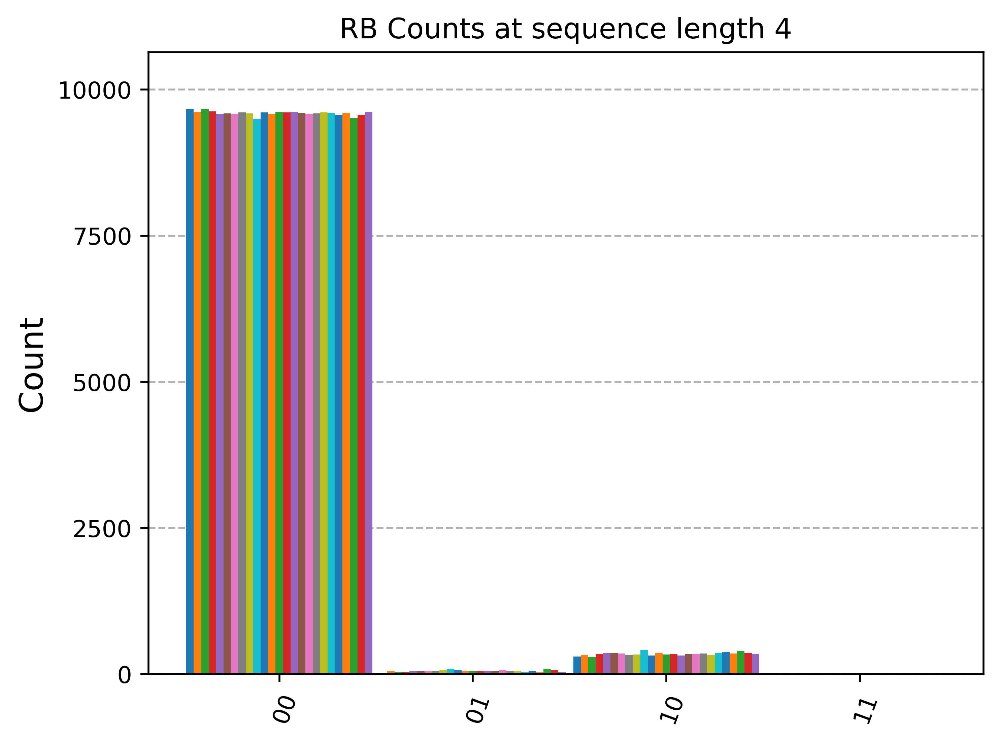

In [33]:
plot_histogram(all_counts[m_ex], title=f"RB Counts at sequence length {m_ex}", bar_labels=False)

**Task**: Compare the histograms between the outcomes for the narrowest and the deepest circuits

NB: You can wrap `plot_histogram()` with `display(*)` to show both results in one cell 

### Analyze the results: what is the average gate fidelity of our gates?

#### Estimate the survival probabilities of every circuit at all sequence lengths

In [34]:
def survival_probabilities(all_counts):
    all_survival = {m: [] for m in all_counts.keys()}
    for m in all_counts.keys():
        survival_m = []
        for counts_sample in all_counts[m]:
            total_counts = sum(counts_sample.values())
            survival_m.append(counts_sample['00'] / total_counts if '00' in counts_sample.keys() else 0)
        all_survival[m] = survival_m
    return all_survival

In [35]:
all_survival_probabilities = survival_probabilities(all_counts)

#### Plot the data

In [36]:
def plot_survival_probabilities(all_survival_probabilities):
    color = (0.247, 0.635, 0.965)
    fig, ax = plt.subplots()
    sequence_lengths = list(all_survival_probabilities.keys())

    flat_fidelity_data = list(chain.from_iterable(all_survival_probabilities.values()))
    scatter_x = [[m] * len(all_survival_probabilities[m]) for m in sequence_lengths]
    flat_scatter_x = list(chain.from_iterable(scatter_x))

    ax.scatter(flat_scatter_x, flat_fidelity_data, s=4, color=color, alpha=0.15)

    ax.errorbar(
        all_survival_probabilities.keys(),
        [np.mean(x) for x in all_survival_probabilities.values()],
        [np.std(x) / np.sqrt(len(x)) for x in all_survival_probabilities.values()],
        color=color,
        fmt="o",
        markersize=4,
        capsize=4,
        label='Mean probability',
    )

    ax.set_xscale("log")
    plt.xlabel('Clifford RB sequence length (log)')
    plt.ylabel(r'Survival probability of $|00\rangle$')
    plt.title(r"Clifford RB survival probabilities of $|00\rangle$", fontsize=9)

    plt.legend()
    plt.grid()

    # plt.show()
    return fig, ax

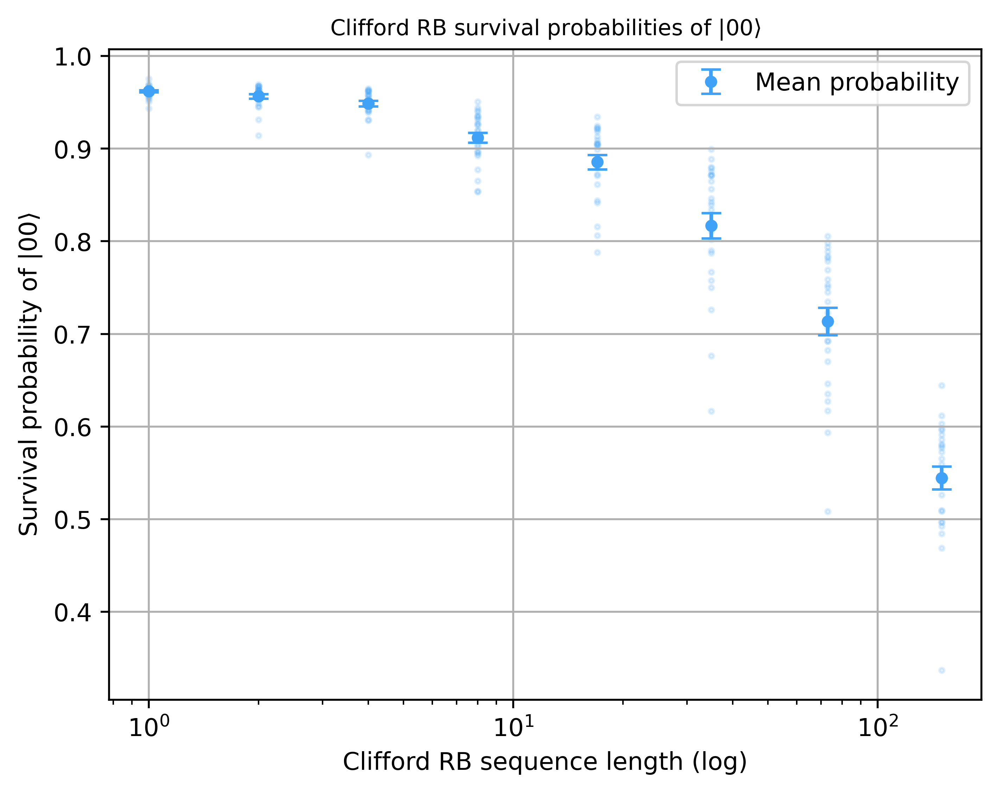

In [21]:
survival_probs_plot = plot_survival_probabilities(all_survival_probabilities)